## Download Data

In [ ]:
# K_LHR_image.zip
!gdown --id 1tgXDvaT0gwZ0-Z0Dq5UijY-72_CL0APV

# traffic-signs-classification.zip
!gdown --id 1C-1SdIrvyd7EJ3qQQc3U79_NuCg32dfj

# weather-dataset.zip
!gdown --id 1X7SP0BAFd2EIGEmbSEEqgqD1GinM8a4w

# Marvel Heroes.zip
!gdown --id 1K2WUFaCxy4va__20i7ibZiSxt1K0am6u


In [ ]:
## MAIN: 
1) Xây dựng ResNet_34 (skip connection: add)

2) Xây dựng Densenet121 (skip connection: concatenate)

3) Xây dựng Unet (skip connection concatenate)

4) Weather recognition: Weather recognition data 
    - ResNet34 (No skip connection)
    - ResNet34 (bài 1)
    - Densenet121 (No skip connection)
    - Densenet121 (bài 2)
    - So sánh kết quả 4 models 
    
5) Super Resolution: K_LHR_image data 
    - Unet (No skip connection)
    - Unet (bài 3)
    - So sánh kết quả 2 models
    
## OPTIONAL:
6) Xây dựng ResNet34_v2 (skip connection: add)

7) Weather recognition: Weather recognition data 
    - ResNet34_V2 (No skip connection)
    - ResNet34_V2 (bài 6)
    - So sánh kết quả với bài 4
    
8 ) Marvel Heroes Classification: Marvel Heroes data 
    - ResNet34 (skip connection: Add)
    - ResNet34_V2 (skip connection: Add)
    - Densenet121 (skip connection: Add)
    
9) Marvel Heroes Classification: Marvel Heroes data 
    - ResNet34 (skip connection: Concatenate)
    - ResNet34_V2 (skip connection: Concatenate)
    - Densenet121 (skip connection: Concatenate)
    - So sánh kết quả với bài 8
    
10) Inpainting image: generate inpainting data
    - Unet 

In [ ]:
import os 
import cv2
import glob
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Model

In [ ]:
os.environ["TF_CPP_MIN_LOG_LEVEL"]="2"
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

## Problem1: Skip Connection ResNet34

In [ ]:
class BuildResNet34():
    def __init__(self):
        pass
    def identity_block(self, inputs, filters, method, is_skip_connection=True):
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(inputs)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        
        if is_skip_connection:
            if method == 'add':
                skip_connection = layers.add([inputs, x])
                x = layers.Activation('relu')(skip_connection)
            else:
                skip_connection = layers.Concatenate(axis=-1)([inputs,x])
                x = layers.Activation('relu')(skip_connection)
                x = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', use_bias=False)(x)
                x = layers.BatchNormalization()(x)
                x = layers.Activation('relu')(x)
                
        else:
            x = layers.Activation('relu')(x)
        

        return x
    
    
    def projection_block(self, inputs, filters, method, strides=2, is_skip_connection=True):
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', strides=strides, use_bias=False)(inputs)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        
        
        
        if is_skip_connection:
            shortcut = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', 
                                 strides=strides, use_bias=False)(inputs)
            shortcut = layers.BatchNormalization()(shortcut)
            if method == 'add':
                skip_connection = layers.add([shortcut, x])
                x = layers.Activation('relu')(skip_connection)
            else:
                skip_connection = layers.Concatenate(axis=-1)([shortcut,x])
                x = layers.Activation('relu')(skip_connection)
                x = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', use_bias=False)(x)
                x = layers.BatchNormalization()(x)
                x = layers.Activation('relu')(x)
        else:
            x = layers.Activation('relu')(x)
        
        return x
    
    def build_model(self, is_skip_connection, classes, method='add', input_shape=(224,224,3)):
        inputs = layers.Input(shape=input_shape)
        # conv1
#         x = layers.Conv2D(filters=64, kernel_size=(7,7), padding='same', strides=2, use_bias=False)(inputs)
#         x = layers.BatchNormalization()(x)
#         x = layers.ZeroPadding2D(padding=(1, 1))(x)
#         x = layers.MaxPooling2D(pool_size=(3,3), strides=2)(x)
        
        x = layers.ZeroPadding2D(padding=((3, 3)))(inputs)
        x = layers.Conv2D(64, 7, strides=2, use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.ZeroPadding2D(padding=((1, 1)))(x)
        x = layers.MaxPooling2D(3, strides=2)(x)
        
        # conv2_X
        x = self.identity_block(x, filters=64, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=64, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=64, method=method, is_skip_connection=is_skip_connection)
        
        # conv3_x
        x = self.projection_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        
        # conv4_x
        x = self.projection_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        
        # conv5_x
        x = self.projection_block(x, filters=512, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=512, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=512, method=method, is_skip_connection=is_skip_connection)
        
        x = layers.GlobalAveragePooling2D()(x)
        x = layers.Dense(classes, activation='softmax')(x)
        
        model = Model(inputs=inputs, outputs=x)
        
        return model
        
    

In [ ]:
build_resnet34 = BuildResNet34()
resnet34_model = build_resnet34.build_model(is_skip_connection=True, classes=1000)

In [ ]:
resnet34_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv2d (Conv2D)                (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                              

In [ ]:
resnet34_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv2d (Conv2D)                (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                              

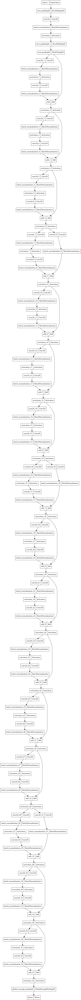

In [ ]:
tf.keras.utils.plot_model(resnet34_model)

## Problem2: Skip Connection Densenet121

In [ ]:
class BuildDensenet121():
    def __init__(self):
        pass
    
    
    def conv_block(self, inputs, method, k=32, is_skip_connection=True):
        x = layers.BatchNormalization()(inputs)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=4*k, kernel_size=(1,1), use_bias=False)(x)
        
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=k, kernel_size=(3,3), padding='same', use_bias=False)(x)
        
        if is_skip_connection:
            if method=='add':
                skip_connection = layers.add([inputs,x])
                skip_connection = layers.BatchNormalization()(skip_connection)
                skip_connection = layers.Activation('relu')(skip_connection)
                skip_connection = layers.Conv2D(filters=k+inputs.shape[-1], kernel_size=(1,1), padding='same', 
                                                use_bias=False)(skip_connection)
            else:
                skip_connection = layers.Concatenate(axis=-1)([inputs,x])
        else:
            skip_connection = x
        
        return skip_connection
    
    
    def dense_block(self, x, nums_block, method, k=32, is_skip_connection=True):
        for i in range(nums_block):
            x = self.conv_block(x, 32, is_skip_connection=is_skip_connection)
        return x
        
    
    
    def trasition_layer(self, inputs, fraction=0.5):
        channels = inputs.shape[-1]
        x = layers.BatchNormalization()(inputs)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=int(fraction*channels), kernel_size=(1,1), use_bias=False)(x)
        x = layers.AveragePooling2D(2, strides=2)(x)
        
        return x
    
    def build_model(self, is_skip_connection, classes, method='concat', input_shape=(224,224,3)):
        inputs = layers.Input(shape=input_shape)
#         x = layers.Conv2D(filters=64, kernel_size=(7,7), strides=2, padding='same', use_bias=False)(inputs)
#         x = layers.BatchNormalization()(x)
#         x = layers.Activation('relu')(x)
#         x = layers.ZeroPadding2D(padding=(1, 1))(x)
#         x = layers.MaxPooling2D(pool_size=3, strides=2)(x)
        
        x = layers.ZeroPadding2D(padding=((3, 3)))(inputs)
        x = layers.Conv2D(64, 7, strides=2, use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.ZeroPadding2D(padding=((1, 1)))(x)
        x = layers.MaxPooling2D(3, strides=2)(x)
        
        # 1-6
        x = self.dense_block(x, nums_block=6, method=method, is_skip_connection=is_skip_connection)
        x = self.trasition_layer(x)
        
        # 2-12
        x = self.dense_block(x, nums_block=12, method=method, is_skip_connection=is_skip_connection)
        x = self.trasition_layer(x)
        
        # 3-24
        x = self.dense_block(x, nums_block=24, method=method, is_skip_connection=is_skip_connection)
        x = self.trasition_layer(x)
        
        #4-16
        x = self.dense_block(x, nums_block=16, method=method, is_skip_connection=is_skip_connection)
        
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.GlobalAveragePooling2D()(x)
        x = layers.Dense(classes, activation='softmax')(x)
        
        model = Model(inputs=inputs, outputs=x)
        
        return model

In [ ]:
build_densenet121 = BuildDensenet121()
densenet121_model = build_densenet121.build_model(is_skip_connection=True, classes=1000)

In [ ]:
densenet121_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_2[0][0]']                
 D)                                                                                               
                                                                                                  
 conv2d_36 (Conv2D)             (None, 112, 112, 64  9408        ['zero_padding2d_2[0][0]']       
                                )                                                           

In [ ]:
a = tf.keras.applications.densenet.DenseNet121()
a.summary()

Model: "densenet121"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_4 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_3[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_4[0][0]']       
                                )                                                       

In [ ]:
tf.keras.utils.plot_model(densenet121_model)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.785422 to fit



## Problem6: Skip Connection ResNet34_V2

In [ ]:
class BuildResNet34_v2():
    def __init__(self):
        pass
    
    
    def identity_block(self, inputs, filters, method, is_skip_connection=True):
        x = layers.BatchNormalization()(inputs)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        
        if is_skip_connection:
            if method == 'add':
                return layers.add([inputs, x])
            else:
                x = layers.Concatenate(axis=-1)([inputs,x])
                x = layers.BatchNormalization()(x)
                x = layers.Activation('relu')(x)
                x = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', use_bias=False)(x)
                return x
        else:
            return x
        
    
    def projection_block(self, inputs, filters, method, is_skip_connection=True):
        x = layers.BatchNormalization()(inputs)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', strides=2, use_bias=False)(x)
        
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        
        
        if is_skip_connection:
            shortcut = layers.BatchNormalization()(inputs)
            shortcut = layers.Activation('relu')(shortcut)
            shortcut = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', 
                                 strides=2, use_bias=False)(shortcut)
            if method == 'add':
                return layers.add([shortcut,x])
            else:
                x = layers.Concatenate(axis=-1)([shortcut,x])
                x = layers.BatchNormalization()(x)
                x = layers.Activation('relu')(x)
                x = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', use_bias=False)(x)
                return x
        else:
            return x
    
    def build_model(self, is_skip_connection, classes, method='add', input_shape=(224,224,3)):
        inputs = layers.Input(shape=input_shape)
        x = layers.ZeroPadding2D(padding=(3,3))(inputs)
        x = layers.Conv2D(filters=64, kernel_size=(7,7), strides=2, use_bias=False)(x)
        x = layers.ZeroPadding2D(padding=(1,1))(x)
        x = layers.MaxPooling2D(pool_size=(3,3), strides=2)(x)
        
        # conv2_X
        x = self.identity_block(x, filters=64, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=64, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=64, method=method, is_skip_connection=is_skip_connection)
        
        # conv3_x
        x = self.projection_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=128, method=method, is_skip_connection=is_skip_connection)
        
        # conv4_x
        x = self.projection_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=256, method=method, is_skip_connection=is_skip_connection)
        
        # conv5_x
        x = self.projection_block(x, filters=512, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=512, method=method, is_skip_connection=is_skip_connection)
        x = self.identity_block(x, filters=512, method=method, is_skip_connection=is_skip_connection)
        
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.GlobalAveragePooling2D()(x)
        x = layers.Dense(classes, activation='softmax')(x)
        
        model = Model(inputs=inputs, outputs=x)
        
        return model
         
            
        
        


In [ ]:
build_resnet34_v2 = BuildResNet34_v2()
resnet34_v2_model = build_resnet34_v2.build_model(is_skip_connection=True, method='concat', classes=1000)

In [ ]:
resnet34_v2_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_6 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_4[0][0]']                
 D)                                                                                               
                                                                                                  
 conv2d_156 (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_6[0][0]']       
                                )                                                           

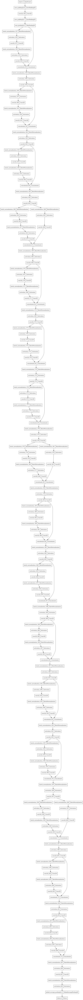

In [ ]:
tf.keras.utils.plot_model(resnet34_v2_model)

## Problem7: Weather Recognition ResNet34_V2

In [ ]:
# list đường dẫn các file ảnh
WEATHER_DATA_PATH = '/media/aivn24/partition1/Khoa/CNN2/weather-dataset/dataset'
path_imgs = list(glob.glob(WEATHER_DATA_PATH+'/**/*.jpg'))


In [ ]:
# split đường dẫn các file để lấy label cho ảnh và tao thành dataframe để  thống kê
labels = list(map(lambda x:os.path.split(os.path.split(x)[0])[1], path_imgs))
file_path = pd.Series(path_imgs, name='File_Path').astype(str)
labels = pd.Series(labels, name='Labels')
data = pd.concat([file_path, labels], axis=1)
data = data.sample(frac=1).reset_index(drop=True)
data.head()

,File_Path,Labels
0,/media/aivn24/partition1/Khoa/CNN2/weather-dat...,snow
1,/media/aivn24/partition1/Khoa/CNN2/weather-dat...,snow
2,/media/aivn24/partition1/Khoa/CNN2/weather-dat...,rime
3,/media/aivn24/partition1/Khoa/CNN2/weather-dat...,rainbow
4,/media/aivn24/partition1/Khoa/CNN2/weather-dat...,rime


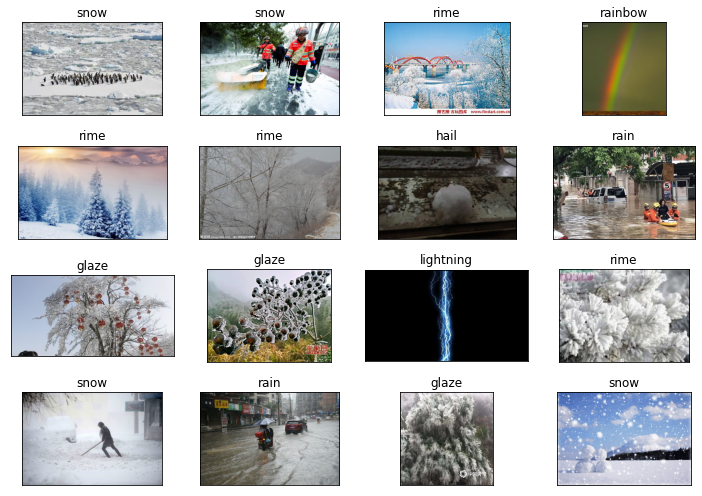

In [ ]:
# vẽ các ảnh tương ứng với label
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(10, 7),
                        subplot_kw={'xticks': [], 'yticks': []})
for i, ax in enumerate(axes.flat):
    ax.imshow(plt.imread(data.File_Path[i]))
    ax.set_title(data.Labels[i])
plt.tight_layout()
plt.show()

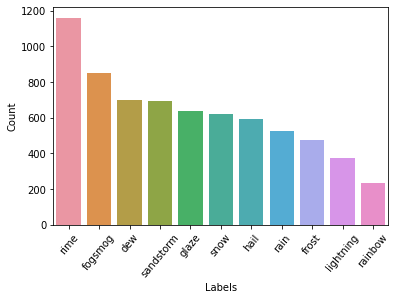

In [ ]:
# Thống kê số lượng ảnh cho từng label 
counts = data.Labels.value_counts()
sns.barplot(x=counts.index, y=counts)
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=50);

In [ ]:
batch_size = 32
img_height = 224
img_width = 224

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  directory=WEATHER_DATA_PATH,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 6862 files belonging to 11 classes.
Using 5490 files for training.


In [ ]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  directory=WEATHER_DATA_PATH,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 6862 files belonging to 11 classes.
Using 1372 files for validation.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['dew', 'fogsmog', 'frost', 'glaze', 'hail', 'lightning', 'rain', 'rainbow', 'rime', 'sandstorm', 'snow']


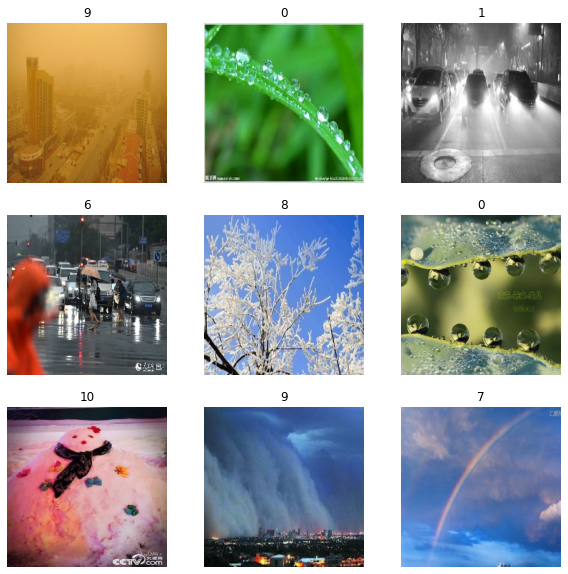

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

#### Data Augmentation

In [ ]:
data_augmentation = tf.keras.Sequential([
      layers.Lambda(lambda x: tf.keras.applications.vgg19.preprocess_input(x)), 
  layers.RandomFlip("horizontal"),
  layers.RandomRotation(0.1),
  layers.RandomTranslation(height_factor=(-0.1, 0.1), width_factor=(-0.1, 0.1), fill_mode='nearest')
])

In [ ]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32,)


In [ ]:
labels_batch

<tf.Tensor: shape=(32,), dtype=int32, numpy=
array([ 7,  3,  9, 10, 10,  4,  1,  6,  0,  0,  8,  0,  8, 10,  3,  1,  8,
        2,  1,  0,  2,  2,  7,  6,  0,  9,  9,  5,  9, 10,  6,  0],
      dtype=int32)>

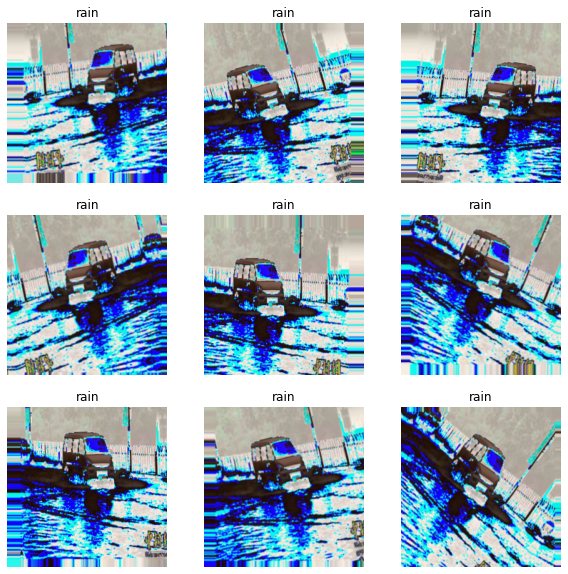

In [ ]:

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(data_augmentation(np.expand_dims(images[0].numpy(),axis=0).astype("uint8"))[0])
    plt.title(class_names[labels[0]])
    plt.axis("off")

### ResNet34_v2 No Skip Connection

In [ ]:
build_resnet34_v2 = BuildResNet34_v2()
resnet34_v2_model_noskip = build_resnet34_v2.build_model(is_skip_connection=False, classes=11)

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = resnet34_v2_model_noskip(x)
weather_resnet34_v2_model_noskip = Model(inputs=image_input, outputs=x)

weather_resnet34_v2_model_noskip.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 model_3 (Functional)        (None, 11)                21131723  
                                                                 
Total params: 21,131,723
Trainable params: 21,116,491
Non-trainable params: 15,232
_________________________________________________________________


In [ ]:
weather_resnet34_v2_model_noskip.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 50

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model_noskip.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
# os.makedirs
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)
learning_rate_reduction = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience = 5, 
                                            verbose=1,
                                            factor=0.5, 
                                            min_lr=0.00001)



history = weather_resnet34_v2_model_noskip.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/50
172/172 [==============================] - ETA: 0s - loss: 1.8824 - accuracy: 0.3383
Epoch 00001: val_accuracy improved from -inf to 0.11152, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model_noskip.h5
172/172 [==============================] - 26s 136ms/step - loss: 1.8824 - accuracy: 0.3383 - val_loss: 6.7269 - val_accuracy: 0.1115
Epoch 2/50
171/172 [============================>.] - ETA: 0s - loss: 1.4282 - accuracy: 0.5026
Epoch 00002: val_accuracy improved from 0.11152 to 0.25656, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model_noskip.h5
172/172 [==============================] - 10s 56ms/step - loss: 1.4296 - accuracy: 0.5020 - val_loss: 3.2486 - val_accuracy: 0.2566
Epoch 3/50
172/172 [==============================] - ETA: 0s - loss: 1.3131 - accuracy: 0.5461
Epoch 00003: val_accuracy improved from 0.25656 to 0.55758, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_re

171/172 [============================>.] - ETA: 0s - loss: 0.8156 - accuracy: 0.7140
Epoch 00026: val_accuracy did not improve from 0.65962
172/172 [==============================] - 9s 54ms/step - loss: 0.8162 - accuracy: 0.7142 - val_loss: 1.1373 - val_accuracy: 0.6363
Epoch 27/50
171/172 [============================>.] - ETA: 0s - loss: 0.8205 - accuracy: 0.7175
Epoch 00027: val_accuracy improved from 0.65962 to 0.66764, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model_noskip.h5
172/172 [==============================] - 10s 57ms/step - loss: 0.8221 - accuracy: 0.7169 - val_loss: 1.0610 - val_accuracy: 0.6676
Epoch 28/50
172/172 [==============================] - ETA: 0s - loss: 0.7950 - accuracy: 0.7288
Epoch 00028: val_accuracy did not improve from 0.66764
172/172 [==============================] - 9s 54ms/step - loss: 0.7950 - accuracy: 0.7288 - val_loss: 1.0506 - val_accuracy: 0.6552
Epoch 29/50
171/172 [============================>.] - E

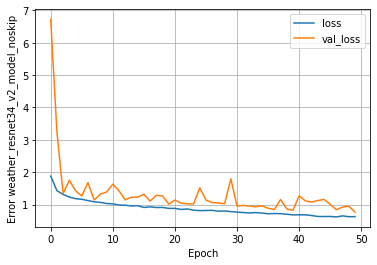

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error weather_resnet34_v2_model_noskip')
plt.legend()
plt.grid(True)

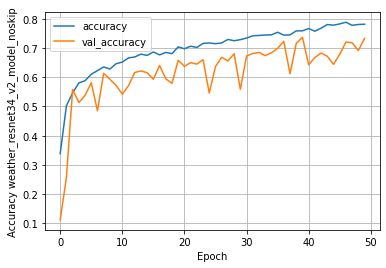

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy weather_resnet34_v2_model_noskip')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
45,0.633447,0.781967,1.007207,0.677843,45
46,0.618447,0.787614,0.840910,0.720117,46
47,0.650567,0.777049,0.922059,0.717201,47
48,0.624822,0.779964,0.951498,0.690962,48
49,0.626962,0.780874,0.766091,0.732507,49


### ResNet34_v2

In [ ]:
build_resnet34_v2 = BuildResNet34_v2()
resnet34_v2_model = build_resnet34_v2.build_model(is_skip_connection=True, classes=11)

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = resnet34_v2_model(x)
weather_resnet34_v2_model = Model(inputs=image_input, outputs=x)

weather_resnet34_v2_model.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 model_5 (Functional)        (None, 11)                21305547  
                                                                 
Total params: 21,305,547
Trainable params: 21,289,419
Non-trainable params: 16,128
_________________________________________________________________


In [ ]:
weather_resnet34_v2_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 50

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
# os.makedirs
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)
learning_rate_reduction = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience = 5, 
                                            verbose=1,
                                            factor=0.5, 
                                            min_lr=0.00001)



history = weather_resnet34_v2_model.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/50
171/172 [============================>.] - ETA: 0s - loss: 1.3471 - accuracy: 0.5515
Epoch 00001: val_accuracy improved from -inf to 0.55612, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model.h5
172/172 [==============================] - 12s 60ms/step - loss: 1.3470 - accuracy: 0.5521 - val_loss: 1.3495 - val_accuracy: 0.5561
Epoch 2/50
171/172 [============================>.] - ETA: 0s - loss: 1.0861 - accuracy: 0.6323
Epoch 00002: val_accuracy improved from 0.55612 to 0.58673, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model.h5
172/172 [==============================] - 11s 61ms/step - loss: 1.0859 - accuracy: 0.6321 - val_loss: 1.2078 - val_accuracy: 0.5867
Epoch 3/50
171/172 [============================>.] - ETA: 0s - loss: 0.9844 - accuracy: 0.6663
Epoch 00003: val_accuracy improved from 0.58673 to 0.61589, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/weather_resnet34_v2_model

Epoch 27/50
171/172 [============================>.] - ETA: 0s - loss: 0.3843 - accuracy: 0.8648
Epoch 00027: val_accuracy did not improve from 0.78717
172/172 [==============================] - 10s 58ms/step - loss: 0.3851 - accuracy: 0.8647 - val_loss: 0.7932 - val_accuracy: 0.7544
Epoch 28/50
172/172 [==============================] - ETA: 0s - loss: 0.3755 - accuracy: 0.8665
Epoch 00028: val_accuracy did not improve from 0.78717
172/172 [==============================] - 10s 58ms/step - loss: 0.3755 - accuracy: 0.8665 - val_loss: 0.7937 - val_accuracy: 0.7362
Epoch 29/50
171/172 [============================>.] - ETA: 0s - loss: 0.3850 - accuracy: 0.8618
Epoch 00029: val_accuracy did not improve from 0.78717
172/172 [==============================] - 10s 58ms/step - loss: 0.3858 - accuracy: 0.8617 - val_loss: 0.8472 - val_accuracy: 0.7617
Epoch 30/50
171/172 [============================>.] - ETA: 0s - loss: 0.3670 - accuracy: 0.8651
Epoch 00030: val_accuracy did not improve from 0

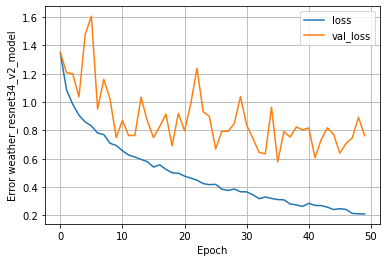

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error weather_resnet34_v2_model')
plt.legend()
plt.grid(True)

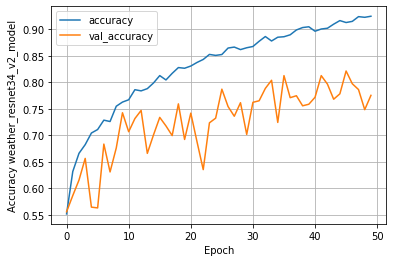

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy weather_resnet34_v2_model')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
45,0.247416,0.912750,0.639103,0.821429,45
46,0.241527,0.914936,0.707445,0.797376,46
47,0.213780,0.923862,0.746585,0.786443,47
48,0.210947,0.922587,0.892338,0.748542,48
49,0.210208,0.924590,0.762859,0.775510,49


 ## Problem8: Marvel Heroes Classification ADD Operator

In [ ]:
# list đường dẫn các file ảnh
MARVEL_HEROES_DATA_PATH = '/media/aivn24/partition2/Khoa/AI2021/CNN_advanced/data/Marvel_Heroes/marvel'
train_path_imgs = list(glob.glob(MARVEL_HEROES_DATA_PATH+'/train/**/*.jpg'))
val_path_imgs = list(glob.glob(MARVEL_HEROES_DATA_PATH+'/valid/**/*.jpg'))


In [ ]:
# split đường dẫn các file để lấy label cho ảnh và tao thành dataframe để  thống kê
labels = list(map(lambda x:os.path.split(os.path.split(x)[0])[1], train_path_imgs))
file_path = pd.Series(train_path_imgs, name='File_Path').astype(str)
labels = pd.Series(labels, name='Labels')
data = pd.concat([file_path, labels], axis=1)
data = data.sample(frac=1).reset_index(drop=True)
data.head()

,File_Path,Labels
0,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,captain america
1,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,captain america
2,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,doctor strange
3,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,doctor strange
4,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,loki


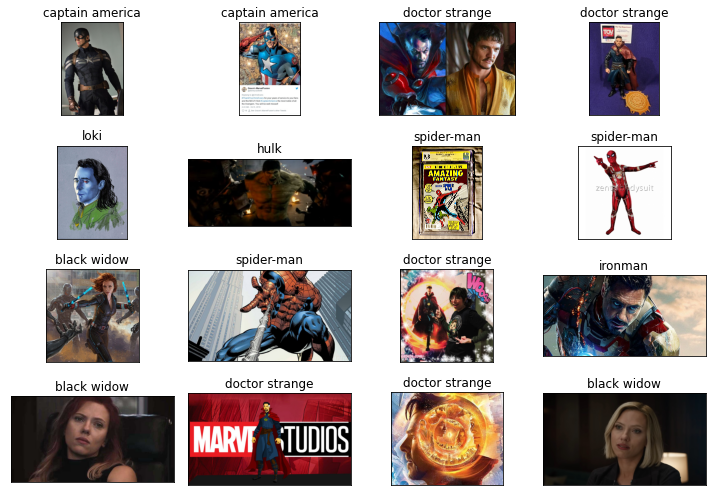

In [ ]:
# vẽ các ảnh tương ứng với label
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(10, 7),
                        subplot_kw={'xticks': [], 'yticks': []})
for i, ax in enumerate(axes.flat):
    ax.imshow(plt.imread(data.File_Path[i]))
    ax.set_title(data.Labels[i])
plt.tight_layout()
plt.show()

In [ ]:
data.Labels.value_counts()

spider-man         206
doctor strange     180
hulk               169
black widow        168
captain america    159
loki               157
ironman            154
thanos             153
Name: Labels, dtype: int64

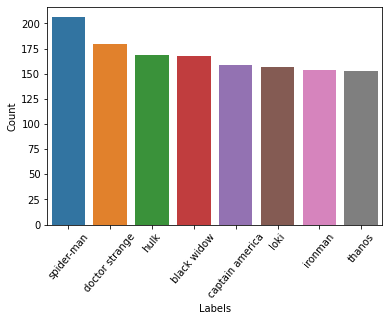

In [ ]:
# Thống kê số lượng ảnh cho từng label 
counts = data.Labels.value_counts()
sns.barplot(x=counts.index, y=counts)
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=50);

In [ ]:
batch_size = 32
img_height = 224
img_width = 224

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  directory= os.path.join(MARVEL_HEROES_DATA_PATH, 'train'),
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 1346 files belonging to 8 classes.


In [ ]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  directory=os.path.join(MARVEL_HEROES_DATA_PATH, 'valid'),
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 208 files belonging to 8 classes.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['black widow', 'captain america', 'doctor strange', 'hulk', 'ironman', 'loki', 'spider-man', 'thanos']


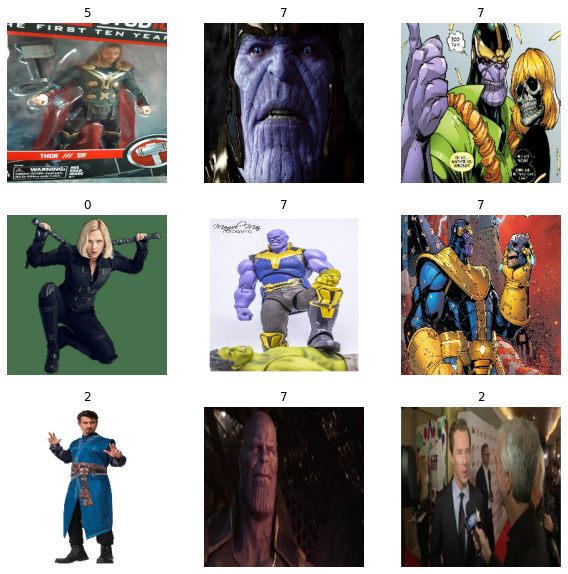

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

### Data Augmentation

In [ ]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2),
    layers.RandomTranslation(height_factor=(-0.1, 0.1), width_factor=(-0.1, 0.1)
                                        , fill_mode='nearest'),
])

In [ ]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32,)


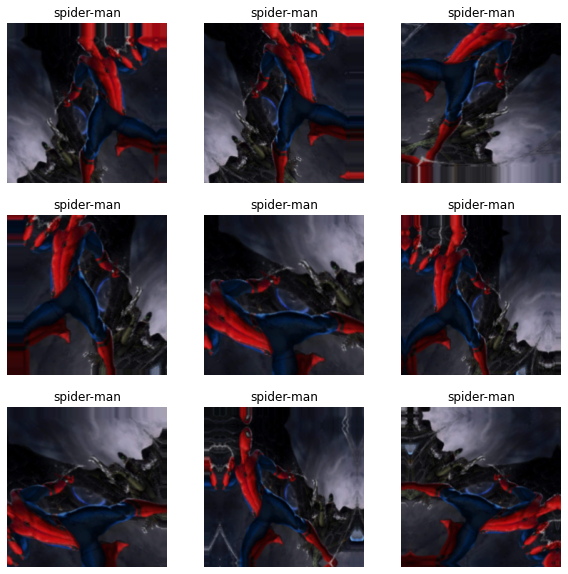

In [ ]:

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(data_augmentation(np.expand_dims(images[0].numpy(),axis=0).astype("uint8"))[0])
    plt.title(class_names[labels[0]])
    plt.axis("off")

### ResNet34 (skip connection: Add)

In [ ]:
build_resnet34 = BuildResNet34()
resnet34_model_add = build_resnet34.build_model(is_skip_connection=True, classes=8, method='add')

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = resnet34_model_add(x)
marvel_heroes_resnet34_model_add = Model(inputs=image_input, outputs=x)

marvel_heroes_resnet34_model_add.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 model_3 (Functional)        (None, 8)                 21305800  
                                                                 
Total params: 21,305,800
Trainable params: 21,288,776
Non-trainable params: 17,024
_________________________________________________________________


In [ ]:
marvel_heroes_resnet34_model_add.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 150

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_add.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)

history = marvel_heroes_resnet34_model_add.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/150
43/43 [==============================] - ETA: 0s - loss: 2.3751 - accuracy: 0.1872
Epoch 00001: val_accuracy improved from -inf to 0.14423, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_add.h5
43/43 [==============================] - 6s 81ms/step - loss: 2.3751 - accuracy: 0.1872 - val_loss: 13.5100 - val_accuracy: 0.1442
Epoch 2/150
42/43 [============================>.] - ETA: 0s - loss: 1.9768 - accuracy: 0.2716
Epoch 00002: val_accuracy improved from 0.14423 to 0.19712, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_add.h5
43/43 [==============================] - 3s 72ms/step - loss: 1.9777 - accuracy: 0.2712 - val_loss: 2.4830 - val_accuracy: 0.1971
Epoch 3/150
42/43 [============================>.] - ETA: 0s - loss: 1.8096 - accuracy: 0.3400
Epoch 00003: val_accuracy improved from 0.19712 to 0.24038, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resne

Epoch 27/150
42/43 [============================>.] - ETA: 0s - loss: 0.8177 - accuracy: 0.7307
Epoch 00027: val_accuracy did not improve from 0.60096
43/43 [==============================] - 3s 60ms/step - loss: 0.8186 - accuracy: 0.7303 - val_loss: 1.5386 - val_accuracy: 0.5144
Epoch 28/150
42/43 [============================>.] - ETA: 0s - loss: 0.8661 - accuracy: 0.6942
Epoch 00028: val_accuracy did not improve from 0.60096
43/43 [==============================] - 3s 60ms/step - loss: 0.8665 - accuracy: 0.6939 - val_loss: 1.4942 - val_accuracy: 0.5337
Epoch 29/150
42/43 [============================>.] - ETA: 0s - loss: 0.8320 - accuracy: 0.7195
Epoch 00029: val_accuracy did not improve from 0.60096
43/43 [==============================] - 3s 61ms/step - loss: 0.8318 - accuracy: 0.7199 - val_loss: 1.4411 - val_accuracy: 0.5769
Epoch 30/150
42/43 [============================>.] - ETA: 0s - loss: 0.8264 - accuracy: 0.7188
Epoch 00030: val_accuracy did not improve from 0.60096
43/43 

42/43 [============================>.] - ETA: 0s - loss: 0.5043 - accuracy: 0.8155
Epoch 00055: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 60ms/step - loss: 0.5046 - accuracy: 0.8150 - val_loss: 1.1362 - val_accuracy: 0.6490
Epoch 56/150
42/43 [============================>.] - ETA: 0s - loss: 0.5152 - accuracy: 0.8318
Epoch 00056: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 60ms/step - loss: 0.5190 - accuracy: 0.8306 - val_loss: 1.2752 - val_accuracy: 0.6058
Epoch 57/150
43/43 [==============================] - ETA: 0s - loss: 0.5435 - accuracy: 0.8113
Epoch 00057: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 60ms/step - loss: 0.5435 - accuracy: 0.8113 - val_loss: 1.2335 - val_accuracy: 0.6298
Epoch 58/150
42/43 [============================>.] - ETA: 0s - loss: 0.4577 - accuracy: 0.8504
Epoch 00058: val_accuracy improved from 0.65865 to 0.66346, saving model t

Epoch 84/150
42/43 [============================>.] - ETA: 0s - loss: 0.3063 - accuracy: 0.8958
Epoch 00084: val_accuracy did not improve from 0.68750
43/43 [==============================] - 3s 60ms/step - loss: 0.3060 - accuracy: 0.8960 - val_loss: 1.2059 - val_accuracy: 0.6635
Epoch 85/150
42/43 [============================>.] - ETA: 0s - loss: 0.2964 - accuracy: 0.9018
Epoch 00085: val_accuracy did not improve from 0.68750
43/43 [==============================] - 3s 61ms/step - loss: 0.2965 - accuracy: 0.9019 - val_loss: 1.3893 - val_accuracy: 0.6106
Epoch 86/150
42/43 [============================>.] - ETA: 0s - loss: 0.3307 - accuracy: 0.8891
Epoch 00086: val_accuracy did not improve from 0.68750
43/43 [==============================] - 3s 60ms/step - loss: 0.3313 - accuracy: 0.8886 - val_loss: 1.3585 - val_accuracy: 0.6202
Epoch 87/150
42/43 [============================>.] - ETA: 0s - loss: 0.3846 - accuracy: 0.8534
Epoch 00087: val_accuracy did not improve from 0.68750
43/43 

Epoch 113/150
42/43 [============================>.] - ETA: 0s - loss: 0.2910 - accuracy: 0.9055
Epoch 00113: val_accuracy improved from 0.71635 to 0.72596, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_add.h5
43/43 [==============================] - 3s 73ms/step - loss: 0.2907 - accuracy: 0.9056 - val_loss: 1.1634 - val_accuracy: 0.7260
Epoch 114/150
42/43 [============================>.] - ETA: 0s - loss: 0.2050 - accuracy: 0.9271
Epoch 00114: val_accuracy did not improve from 0.72596
43/43 [==============================] - 3s 60ms/step - loss: 0.2052 - accuracy: 0.9272 - val_loss: 1.1660 - val_accuracy: 0.6827
Epoch 115/150
42/43 [============================>.] - ETA: 0s - loss: 0.2321 - accuracy: 0.9211
Epoch 00115: val_accuracy did not improve from 0.72596
43/43 [==============================] - 3s 60ms/step - loss: 0.2318 - accuracy: 0.9212 - val_loss: 1.2586 - val_accuracy: 0.6827
Epoch 116/150
42/43 [============================>.

Epoch 141/150
42/43 [============================>.] - ETA: 0s - loss: 0.2008 - accuracy: 0.9338
Epoch 00141: val_accuracy did not improve from 0.74038
43/43 [==============================] - 3s 61ms/step - loss: 0.2011 - accuracy: 0.9339 - val_loss: 1.0543 - val_accuracy: 0.6875
Epoch 142/150
42/43 [============================>.] - ETA: 0s - loss: 0.1945 - accuracy: 0.9315
Epoch 00142: val_accuracy did not improve from 0.74038
43/43 [==============================] - 3s 61ms/step - loss: 0.1961 - accuracy: 0.9309 - val_loss: 2.0022 - val_accuracy: 0.5769
Epoch 143/150
42/43 [============================>.] - ETA: 0s - loss: 0.2372 - accuracy: 0.9271
Epoch 00143: val_accuracy did not improve from 0.74038
43/43 [==============================] - 3s 61ms/step - loss: 0.2391 - accuracy: 0.9264 - val_loss: 1.5168 - val_accuracy: 0.6106
Epoch 144/150
42/43 [============================>.] - ETA: 0s - loss: 0.2335 - accuracy: 0.9204
Epoch 00144: val_accuracy did not improve from 0.74038
43

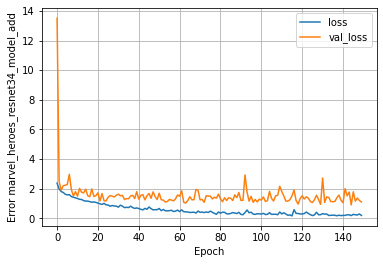

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error marvel_heroes_resnet34_model_add')
plt.legend()
plt.grid(True)

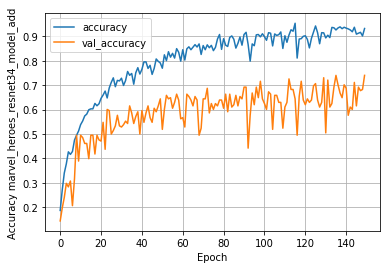

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy marvel_heroes_resnet34_model_add')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
145,0.267369,0.909361,1.790449,0.615385,145
146,0.240757,0.913076,1.160608,0.692308,146
147,0.225352,0.916790,1.367936,0.677885,147
148,0.293208,0.901932,1.203716,0.682692,148
149,0.195854,0.932392,1.104995,0.740385,149


### ResNet34_V2 (skip connection: Add)

In [ ]:
build_resnet34_v2 = BuildResNet34_v2()
resnet34_v2_model_add = build_resnet34_v2.build_model(is_skip_connection=True, classes=8, method='add')

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = resnet34_v2_model_add(x)
marvel_heroes_resnet34_v2_model_add = Model(inputs=image_input, outputs=x)

marvel_heroes_resnet34_v2_model_add.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 model_5 (Functional)        (None, 8)                 21304008  
                                                                 
Total params: 21,304,008
Trainable params: 21,287,880
Non-trainable params: 16,128
_________________________________________________________________


In [ ]:
marvel_heroes_resnet34_v2_model_add.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 150

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_add.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)

history = marvel_heroes_resnet34_v2_model_add.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/150
42/43 [============================>.] - ETA: 0s - loss: 2.0518 - accuracy: 0.2188
Epoch 00001: val_accuracy improved from -inf to 0.17788, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_add.h5
43/43 [==============================] - 5s 77ms/step - loss: 2.0521 - accuracy: 0.2184 - val_loss: 2.2581 - val_accuracy: 0.1779
Epoch 2/150
42/43 [============================>.] - ETA: 0s - loss: 1.7865 - accuracy: 0.3482
Epoch 00002: val_accuracy improved from 0.17788 to 0.24038, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_add.h5
43/43 [==============================] - 3s 70ms/step - loss: 1.7867 - accuracy: 0.3484 - val_loss: 1.9801 - val_accuracy: 0.2404
Epoch 3/150
42/43 [============================>.] - ETA: 0s - loss: 1.6593 - accuracy: 0.4159
Epoch 00003: val_accuracy improved from 0.24038 to 0.29327, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_

Epoch 26/150
42/43 [============================>.] - ETA: 0s - loss: 0.8522 - accuracy: 0.6935
Epoch 00026: val_accuracy did not improve from 0.62500
43/43 [==============================] - 3s 60ms/step - loss: 0.8537 - accuracy: 0.6924 - val_loss: 1.3126 - val_accuracy: 0.5769
Epoch 27/150
42/43 [============================>.] - ETA: 0s - loss: 0.8114 - accuracy: 0.7344
Epoch 00027: val_accuracy did not improve from 0.62500
43/43 [==============================] - 3s 59ms/step - loss: 0.8139 - accuracy: 0.7333 - val_loss: 1.9448 - val_accuracy: 0.4952
Epoch 28/150
43/43 [==============================] - ETA: 0s - loss: 0.7616 - accuracy: 0.7355
Epoch 00028: val_accuracy did not improve from 0.62500
43/43 [==============================] - 3s 60ms/step - loss: 0.7616 - accuracy: 0.7355 - val_loss: 1.2483 - val_accuracy: 0.5721
Epoch 29/150
43/43 [==============================] - ETA: 0s - loss: 0.8505 - accuracy: 0.7259
Epoch 00029: val_accuracy did not improve from 0.62500
43/43 

Epoch 55/150
42/43 [============================>.] - ETA: 0s - loss: 0.6572 - accuracy: 0.7760
Epoch 00055: val_accuracy did not improve from 0.67308
43/43 [==============================] - 3s 59ms/step - loss: 0.6585 - accuracy: 0.7756 - val_loss: 1.1993 - val_accuracy: 0.6490
Epoch 56/150
42/43 [============================>.] - ETA: 0s - loss: 0.5177 - accuracy: 0.8318
Epoch 00056: val_accuracy did not improve from 0.67308
43/43 [==============================] - 3s 61ms/step - loss: 0.5220 - accuracy: 0.8306 - val_loss: 1.4072 - val_accuracy: 0.5721
Epoch 57/150
43/43 [==============================] - ETA: 0s - loss: 0.5880 - accuracy: 0.7935
Epoch 00057: val_accuracy did not improve from 0.67308
43/43 [==============================] - 3s 59ms/step - loss: 0.5880 - accuracy: 0.7935 - val_loss: 1.6961 - val_accuracy: 0.5240
Epoch 58/150
42/43 [============================>.] - ETA: 0s - loss: 0.5503 - accuracy: 0.8162
Epoch 00058: val_accuracy improved from 0.67308 to 0.70673, s

Epoch 84/150
43/43 [==============================] - ETA: 0s - loss: 0.3940 - accuracy: 0.8559
Epoch 00084: val_accuracy did not improve from 0.71635
43/43 [==============================] - 3s 59ms/step - loss: 0.3940 - accuracy: 0.8559 - val_loss: 1.9909 - val_accuracy: 0.5913
Epoch 85/150
43/43 [==============================] - ETA: 0s - loss: 0.3897 - accuracy: 0.8707
Epoch 00085: val_accuracy did not improve from 0.71635
43/43 [==============================] - 3s 58ms/step - loss: 0.3897 - accuracy: 0.8707 - val_loss: 1.3905 - val_accuracy: 0.6683
Epoch 86/150
42/43 [============================>.] - ETA: 0s - loss: 0.3463 - accuracy: 0.8817
Epoch 00086: val_accuracy did not improve from 0.71635
43/43 [==============================] - 3s 58ms/step - loss: 0.3478 - accuracy: 0.8811 - val_loss: 1.4293 - val_accuracy: 0.6538
Epoch 87/150
42/43 [============================>.] - ETA: 0s - loss: 0.3296 - accuracy: 0.8906
Epoch 00087: val_accuracy did not improve from 0.71635
43/43 

Epoch 113/150
42/43 [============================>.] - ETA: 0s - loss: 0.2179 - accuracy: 0.9293
Epoch 00113: val_accuracy did not improve from 0.73558
43/43 [==============================] - 3s 59ms/step - loss: 0.2203 - accuracy: 0.9287 - val_loss: 1.2671 - val_accuracy: 0.6538
Epoch 114/150
42/43 [============================>.] - ETA: 0s - loss: 0.2703 - accuracy: 0.9159
Epoch 00114: val_accuracy did not improve from 0.73558
43/43 [==============================] - 3s 60ms/step - loss: 0.2720 - accuracy: 0.9153 - val_loss: 1.5347 - val_accuracy: 0.5625
Epoch 115/150
42/43 [============================>.] - ETA: 0s - loss: 0.2327 - accuracy: 0.9241
Epoch 00115: val_accuracy did not improve from 0.73558
43/43 [==============================] - 3s 60ms/step - loss: 0.2327 - accuracy: 0.9242 - val_loss: 1.2841 - val_accuracy: 0.6827
Epoch 116/150
43/43 [==============================] - ETA: 0s - loss: 0.1802 - accuracy: 0.9391
Epoch 00116: val_accuracy did not improve from 0.73558
43

Epoch 142/150
42/43 [============================>.] - ETA: 0s - loss: 0.1781 - accuracy: 0.9412
Epoch 00142: val_accuracy did not improve from 0.74519
43/43 [==============================] - 3s 63ms/step - loss: 0.1782 - accuracy: 0.9413 - val_loss: 1.1230 - val_accuracy: 0.7067
Epoch 143/150
42/43 [============================>.] - ETA: 0s - loss: 0.1233 - accuracy: 0.9561
Epoch 00143: val_accuracy improved from 0.74519 to 0.79327, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_add.h5
43/43 [==============================] - 3s 75ms/step - loss: 0.1243 - accuracy: 0.9554 - val_loss: 0.8329 - val_accuracy: 0.7933
Epoch 144/150
42/43 [============================>.] - ETA: 0s - loss: 0.2101 - accuracy: 0.9368
Epoch 00144: val_accuracy did not improve from 0.79327
43/43 [==============================] - 3s 61ms/step - loss: 0.2105 - accuracy: 0.9368 - val_loss: 1.1173 - val_accuracy: 0.7067
Epoch 145/150
42/43 [===========================

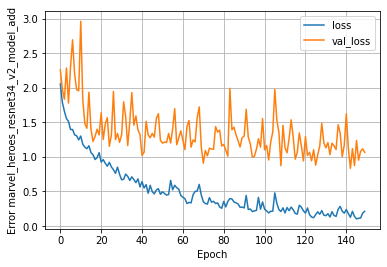

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error marvel_heroes_resnet34_v2_model_add')
plt.legend()
plt.grid(True)

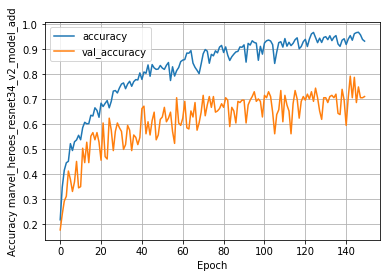

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy marvel_heroes_resnet34_v2_model_add')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
145,0.100841,0.967311,1.235828,0.687500,145
146,0.110494,0.968796,0.951333,0.750000,146
147,0.113330,0.958395,1.078352,0.706731,147
148,0.183432,0.939822,1.115351,0.706731,148
149,0.210946,0.933135,1.064573,0.711538,149


###  Densenet121 (skip connection: Add)

In [ ]:
build_densenet121 = BuildDensenet121()
densenet121_model_add = build_densenet121.build_model(is_skip_connection=True, classes=8, method='add')

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = densenet121_model_add(x)
marvel_heroes_densenet121_model_add = Model(inputs=image_input, outputs=x)

marvel_heroes_densenet121_model_add.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 model_7 (Functional)        (None, 8)                 7045704   
                                                                 
Total params: 7,045,704
Trainable params: 6,962,056
Non-trainable params: 83,648
_________________________________________________________________


In [ ]:
marvel_heroes_densenet121_model_add.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 150

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_add.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)

history = marvel_heroes_densenet121_model_add.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/150
43/43 [==============================] - ETA: 0s - loss: 1.9688 - accuracy: 0.2689
Epoch 00001: val_accuracy improved from -inf to 0.14423, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_add.h5
43/43 [==============================] - 12s 164ms/step - loss: 1.9688 - accuracy: 0.2689 - val_loss: 2.1761 - val_accuracy: 0.1442
Epoch 2/150
42/43 [============================>.] - ETA: 0s - loss: 1.7153 - accuracy: 0.3780
Epoch 00002: val_accuracy improved from 0.14423 to 0.20192, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_add.h5
43/43 [==============================] - 6s 128ms/step - loss: 1.7147 - accuracy: 0.3782 - val_loss: 2.0774 - val_accuracy: 0.2019
Epoch 3/150
42/43 [============================>.] - ETA: 0s - loss: 1.6015 - accuracy: 0.4405
Epoch 00003: val_accuracy improved from 0.20192 to 0.20673, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_hero

42/43 [============================>.] - ETA: 0s - loss: 0.6847 - accuracy: 0.7701
Epoch 00026: val_accuracy did not improve from 0.55288
43/43 [==============================] - 5s 118ms/step - loss: 0.6892 - accuracy: 0.7689 - val_loss: 1.4311 - val_accuracy: 0.5240
Epoch 27/150
42/43 [============================>.] - ETA: 0s - loss: 0.7370 - accuracy: 0.7530
Epoch 00027: val_accuracy improved from 0.55288 to 0.57212, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_add.h5
43/43 [==============================] - 6s 123ms/step - loss: 0.7382 - accuracy: 0.7526 - val_loss: 1.4365 - val_accuracy: 0.5721
Epoch 28/150
42/43 [============================>.] - ETA: 0s - loss: 0.6254 - accuracy: 0.7820
Epoch 00028: val_accuracy did not improve from 0.57212
43/43 [==============================] - 5s 118ms/step - loss: 0.6275 - accuracy: 0.7816 - val_loss: 1.6720 - val_accuracy: 0.5096
Epoch 29/150
42/43 [============================>.] - ETA: 0s

Epoch 54/150
42/43 [============================>.] - ETA: 0s - loss: 0.3847 - accuracy: 0.8780
Epoch 00054: val_accuracy improved from 0.60577 to 0.62019, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_add.h5
43/43 [==============================] - 6s 124ms/step - loss: 0.3883 - accuracy: 0.8767 - val_loss: 1.4072 - val_accuracy: 0.6202
Epoch 55/150
42/43 [============================>.] - ETA: 0s - loss: 0.3653 - accuracy: 0.8802
Epoch 00055: val_accuracy did not improve from 0.62019
43/43 [==============================] - 5s 119ms/step - loss: 0.3666 - accuracy: 0.8796 - val_loss: 2.0625 - val_accuracy: 0.5048
Epoch 56/150
42/43 [============================>.] - ETA: 0s - loss: 0.2943 - accuracy: 0.9085
Epoch 00056: val_accuracy did not improve from 0.62019
43/43 [==============================] - 5s 118ms/step - loss: 0.2971 - accuracy: 0.9071 - val_loss: 1.6301 - val_accuracy: 0.5481
Epoch 57/150
42/43 [============================

42/43 [============================>.] - ETA: 0s - loss: 0.2003 - accuracy: 0.9382
Epoch 00082: val_accuracy did not improve from 0.65865
43/43 [==============================] - 5s 118ms/step - loss: 0.2050 - accuracy: 0.9368 - val_loss: 1.5224 - val_accuracy: 0.5721
Epoch 83/150
42/43 [============================>.] - ETA: 0s - loss: 0.3618 - accuracy: 0.8817
Epoch 00083: val_accuracy did not improve from 0.65865
43/43 [==============================] - 5s 117ms/step - loss: 0.3651 - accuracy: 0.8804 - val_loss: 1.5133 - val_accuracy: 0.5817
Epoch 84/150
42/43 [============================>.] - ETA: 0s - loss: 0.3274 - accuracy: 0.8936
Epoch 00084: val_accuracy did not improve from 0.65865
43/43 [==============================] - 5s 118ms/step - loss: 0.3305 - accuracy: 0.8923 - val_loss: 1.9168 - val_accuracy: 0.5577
Epoch 85/150
42/43 [============================>.] - ETA: 0s - loss: 0.4234 - accuracy: 0.8564
Epoch 00085: val_accuracy did not improve from 0.65865
43/43 [=========

42/43 [============================>.] - ETA: 0s - loss: 0.1536 - accuracy: 0.9464
Epoch 00110: val_accuracy did not improve from 0.67788
43/43 [==============================] - 5s 118ms/step - loss: 0.1551 - accuracy: 0.9458 - val_loss: 1.9295 - val_accuracy: 0.5529
Epoch 111/150
42/43 [============================>.] - ETA: 0s - loss: 0.1686 - accuracy: 0.9457
Epoch 00111: val_accuracy did not improve from 0.67788
43/43 [==============================] - 5s 117ms/step - loss: 0.1689 - accuracy: 0.9458 - val_loss: 2.0064 - val_accuracy: 0.5769
Epoch 112/150
42/43 [============================>.] - ETA: 0s - loss: 0.1429 - accuracy: 0.9531
Epoch 00112: val_accuracy did not improve from 0.67788
43/43 [==============================] - 5s 119ms/step - loss: 0.1477 - accuracy: 0.9517 - val_loss: 1.3015 - val_accuracy: 0.6490
Epoch 113/150
42/43 [============================>.] - ETA: 0s - loss: 0.1321 - accuracy: 0.9554
Epoch 00113: val_accuracy did not improve from 0.67788
43/43 [======

Epoch 139/150
42/43 [============================>.] - ETA: 0s - loss: 0.1725 - accuracy: 0.9516
Epoch 00139: val_accuracy did not improve from 0.67788
43/43 [==============================] - 5s 119ms/step - loss: 0.1740 - accuracy: 0.9510 - val_loss: 1.6761 - val_accuracy: 0.5913
Epoch 140/150
42/43 [============================>.] - ETA: 0s - loss: 0.1308 - accuracy: 0.9576
Epoch 00140: val_accuracy did not improve from 0.67788
43/43 [==============================] - 5s 116ms/step - loss: 0.1324 - accuracy: 0.9569 - val_loss: 1.8239 - val_accuracy: 0.5913
Epoch 141/150
42/43 [============================>.] - ETA: 0s - loss: 0.1504 - accuracy: 0.9531
Epoch 00141: val_accuracy did not improve from 0.67788
43/43 [==============================] - 5s 118ms/step - loss: 0.1514 - accuracy: 0.9525 - val_loss: 1.7067 - val_accuracy: 0.6058
Epoch 142/150
42/43 [============================>.] - ETA: 0s - loss: 0.1361 - accuracy: 0.9606
Epoch 00142: val_accuracy did not improve from 0.67788

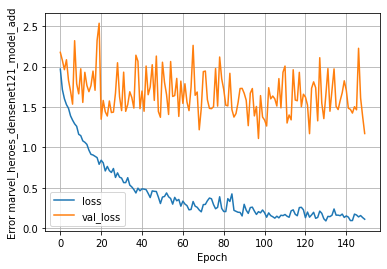

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error marvel_heroes_densenet121_model_add')
plt.legend()
plt.grid(True)

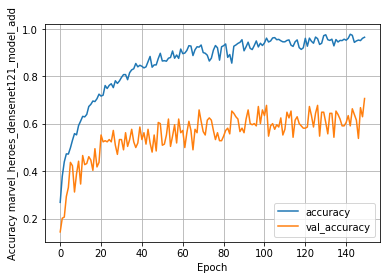

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy marvel_heroes_densenet121_model_add')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
145,0.162621,0.949480,1.464616,0.615385,145
146,0.138895,0.953195,2.226326,0.538462,146
147,0.155862,0.950966,1.611022,0.668269,147
148,0.130871,0.960624,1.382972,0.629808,148
149,0.110179,0.965082,1.171223,0.706731,149


## Problem9: Marvel Heroes Classification  Concatenate

In [ ]:
# list đường dẫn các file ảnh
MARVEL_HEROES_DATA_PATH = '/media/aivn24/partition2/Khoa/AI2021/CNN_advanced/data/Marvel_Heroes/marvel'
train_path_imgs = list(glob.glob(MARVEL_HEROES_DATA_PATH+'/train/**/*.jpg'))
val_path_imgs = list(glob.glob(MARVEL_HEROES_DATA_PATH+'/valid/**/*.jpg'))


In [ ]:
# split đường dẫn các file để lấy label cho ảnh và tao thành dataframe để  thống kê
labels = list(map(lambda x:os.path.split(os.path.split(x)[0])[1], train_path_imgs))
file_path = pd.Series(train_path_imgs, name='File_Path').astype(str)
labels = pd.Series(labels, name='Labels')
data = pd.concat([file_path, labels], axis=1)
data = data.sample(frac=1).reset_index(drop=True)
data.head()

,File_Path,Labels
0,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,doctor strange
1,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,black widow
2,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,captain america
3,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,black widow
4,/media/aivn24/partition2/Khoa/AI2021/CNN_advan...,captain america


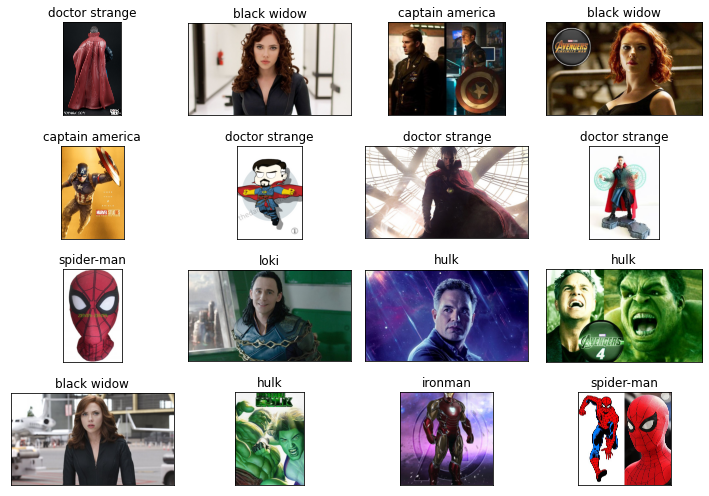

In [ ]:
# vẽ các ảnh tương ứng với label
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(10, 7),
                        subplot_kw={'xticks': [], 'yticks': []})
for i, ax in enumerate(axes.flat):
    ax.imshow(plt.imread(data.File_Path[i]))
    ax.set_title(data.Labels[i])
plt.tight_layout()
plt.show()

In [ ]:
data.Labels.value_counts()

spider-man         206
doctor strange     180
hulk               169
black widow        168
captain america    159
loki               157
ironman            154
thanos             153
Name: Labels, dtype: int64

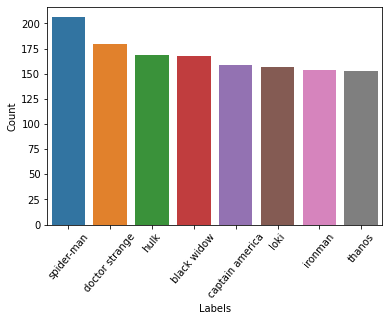

In [ ]:
# Thống kê số lượng ảnh cho từng label 
counts = data.Labels.value_counts()
sns.barplot(x=counts.index, y=counts)
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=50);

In [ ]:
batch_size = 32
img_height = 224
img_width = 224

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  directory=os.path.join(MARVEL_HEROES_DATA_PATH, 'train'),
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 1346 files belonging to 8 classes.


In [ ]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  directory=os.path.join(MARVEL_HEROES_DATA_PATH, 'valid'),
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 208 files belonging to 8 classes.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['black widow', 'captain america', 'doctor strange', 'hulk', 'ironman', 'loki', 'spider-man', 'thanos']


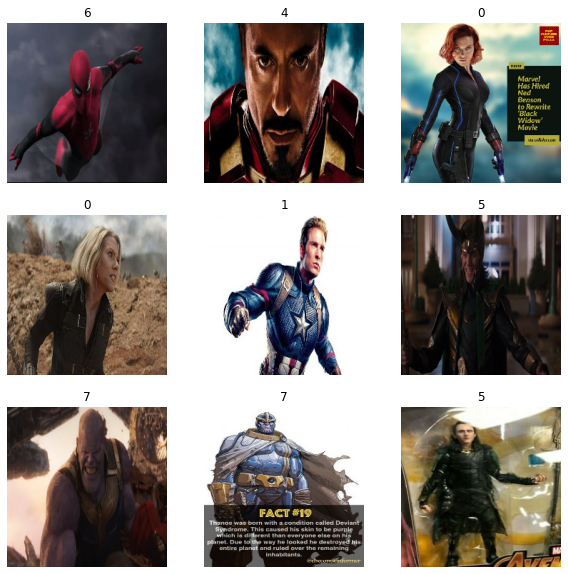

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

### Data Augmentation

In [ ]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2),
    layers.RandomTranslation(height_factor=(-0.1, 0.1), width_factor=(-0.1, 0.1)
                                        , fill_mode='nearest', fill_value=0.0),
])

In [ ]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32,)


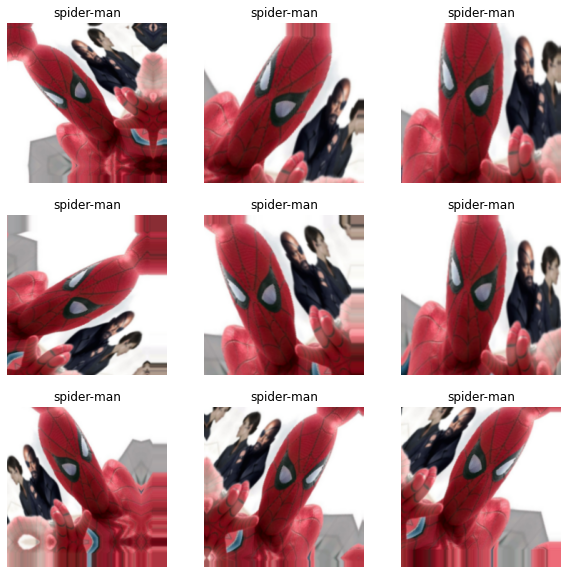

In [ ]:

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(data_augmentation(np.expand_dims(images[0].numpy(),axis=0).astype("uint8"))[0])
    plt.title(class_names[labels[0]])
    plt.axis("off")

### ResNet34 (skip connection: Concatenate)

In [ ]:
build_resnet34 = BuildResNet34()
resnet34_model_concatenate = build_resnet34.build_model(is_skip_connection=True, classes=8, method='concatenate')

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = resnet34_model_concatenate(x)
marvel_heroes_resnet34_model_concatenate = Model(inputs=image_input, outputs=x)

marvel_heroes_resnet34_model_concatenate.summary()

Model: "model_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 sequential_1 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 model_9 (Functional)        (None, 8)                 23835848  
                                                                 
Total params: 23,835,848
Trainable params: 23,811,272
Non-trainable params: 24,576
_________________________________________________________________


In [ ]:
marvel_heroes_resnet34_model_concatenate.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 150

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_concatenate.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)

history = marvel_heroes_resnet34_model_concatenate.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/150
43/43 [==============================] - ETA: 0s - loss: 2.1591 - accuracy: 0.1642
Epoch 00001: val_accuracy improved from -inf to 0.11538, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_concatenate.h5
43/43 [==============================] - 5s 82ms/step - loss: 2.1591 - accuracy: 0.1642 - val_loss: 2.1033 - val_accuracy: 0.1154
Epoch 2/150
42/43 [============================>.] - ETA: 0s - loss: 2.0720 - accuracy: 0.1778
Epoch 00002: val_accuracy improved from 0.11538 to 0.12500, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_concatenate.h5
43/43 [==============================] - 4s 86ms/step - loss: 2.0717 - accuracy: 0.1783 - val_loss: 2.1906 - val_accuracy: 0.1250
Epoch 3/150
42/43 [============================>.] - ETA: 0s - loss: 2.0446 - accuracy: 0.1815
Epoch 00003: val_accuracy improved from 0.12500 to 0.12981, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marv

Epoch 25/150
42/43 [============================>.] - ETA: 0s - loss: 1.5074 - accuracy: 0.4568
Epoch 00025: val_accuracy did not improve from 0.39904
43/43 [==============================] - 3s 72ms/step - loss: 1.5096 - accuracy: 0.4562 - val_loss: 1.8681 - val_accuracy: 0.3606
Epoch 26/150
42/43 [============================>.] - ETA: 0s - loss: 1.4708 - accuracy: 0.4725
Epoch 00026: val_accuracy did not improve from 0.39904
43/43 [==============================] - 3s 73ms/step - loss: 1.4722 - accuracy: 0.4718 - val_loss: 1.6531 - val_accuracy: 0.3750
Epoch 27/150
42/43 [============================>.] - ETA: 0s - loss: 1.4838 - accuracy: 0.4613
Epoch 00027: val_accuracy improved from 0.39904 to 0.40385, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_concatenate.h5
43/43 [==============================] - 4s 85ms/step - loss: 1.4834 - accuracy: 0.4614 - val_loss: 1.6412 - val_accuracy: 0.4038
Epoch 28/150
42/43 [==========================

42/43 [============================>.] - ETA: 0s - loss: 1.1129 - accuracy: 0.6101
Epoch 00052: val_accuracy did not improve from 0.54327
43/43 [==============================] - 3s 72ms/step - loss: 1.1138 - accuracy: 0.6100 - val_loss: 1.4502 - val_accuracy: 0.5288
Epoch 53/150
42/43 [============================>.] - ETA: 0s - loss: 1.0394 - accuracy: 0.6503
Epoch 00053: val_accuracy did not improve from 0.54327
43/43 [==============================] - 3s 72ms/step - loss: 1.0401 - accuracy: 0.6501 - val_loss: 1.6339 - val_accuracy: 0.4808
Epoch 54/150
42/43 [============================>.] - ETA: 0s - loss: 1.0260 - accuracy: 0.6399
Epoch 00054: val_accuracy did not improve from 0.54327
43/43 [==============================] - 3s 72ms/step - loss: 1.0281 - accuracy: 0.6397 - val_loss: 1.5984 - val_accuracy: 0.5048
Epoch 55/150
42/43 [============================>.] - ETA: 0s - loss: 1.0224 - accuracy: 0.6615
Epoch 00055: val_accuracy did not improve from 0.54327
43/43 [============

Epoch 81/150
42/43 [============================>.] - ETA: 0s - loss: 0.7285 - accuracy: 0.7418
Epoch 00081: val_accuracy did not improve from 0.59615
43/43 [==============================] - 3s 73ms/step - loss: 0.7311 - accuracy: 0.7407 - val_loss: 1.4791 - val_accuracy: 0.5288
Epoch 82/150
42/43 [============================>.] - ETA: 0s - loss: 0.8401 - accuracy: 0.7188
Epoch 00082: val_accuracy did not improve from 0.59615
43/43 [==============================] - 3s 75ms/step - loss: 0.8427 - accuracy: 0.7177 - val_loss: 1.7618 - val_accuracy: 0.5481
Epoch 83/150
42/43 [============================>.] - ETA: 0s - loss: 0.7266 - accuracy: 0.7530
Epoch 00083: val_accuracy did not improve from 0.59615
43/43 [==============================] - 3s 75ms/step - loss: 0.7307 - accuracy: 0.7526 - val_loss: 1.4995 - val_accuracy: 0.5577
Epoch 84/150
42/43 [============================>.] - ETA: 0s - loss: 0.7262 - accuracy: 0.7463
Epoch 00084: val_accuracy did not improve from 0.59615
43/43 

42/43 [============================>.] - ETA: 0s - loss: 0.5192 - accuracy: 0.8214
Epoch 00109: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 73ms/step - loss: 0.5231 - accuracy: 0.8202 - val_loss: 1.5206 - val_accuracy: 0.5962
Epoch 110/150
42/43 [============================>.] - ETA: 0s - loss: 0.6126 - accuracy: 0.7850
Epoch 00110: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 72ms/step - loss: 0.6137 - accuracy: 0.7845 - val_loss: 1.7485 - val_accuracy: 0.5433
Epoch 111/150
42/43 [============================>.] - ETA: 0s - loss: 0.6230 - accuracy: 0.7902
Epoch 00111: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 72ms/step - loss: 0.6245 - accuracy: 0.7890 - val_loss: 1.1022 - val_accuracy: 0.6394
Epoch 112/150
42/43 [============================>.] - ETA: 0s - loss: 0.5170 - accuracy: 0.8155
Epoch 00112: val_accuracy did not improve from 0.65865
43/43 [=========

Epoch 138/150
42/43 [============================>.] - ETA: 0s - loss: 0.4544 - accuracy: 0.8430
Epoch 00138: val_accuracy did not improve from 0.67308
43/43 [==============================] - 3s 71ms/step - loss: 0.4579 - accuracy: 0.8425 - val_loss: 1.1197 - val_accuracy: 0.6587
Epoch 139/150
42/43 [============================>.] - ETA: 0s - loss: 0.4210 - accuracy: 0.8452
Epoch 00139: val_accuracy improved from 0.67308 to 0.67788, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_model_concatenate.h5
43/43 [==============================] - 4s 86ms/step - loss: 0.4221 - accuracy: 0.8447 - val_loss: 1.0537 - val_accuracy: 0.6779
Epoch 140/150
42/43 [============================>.] - ETA: 0s - loss: 0.4181 - accuracy: 0.8475
Epoch 00140: val_accuracy did not improve from 0.67788
43/43 [==============================] - 3s 72ms/step - loss: 0.4210 - accuracy: 0.8470 - val_loss: 1.1768 - val_accuracy: 0.6490
Epoch 141/150
42/43 [======================

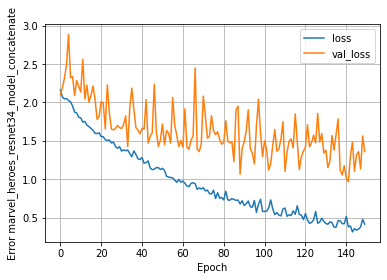

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error marvel_heroes_resnet34_model_concatenate')
plt.legend()
plt.grid(True)

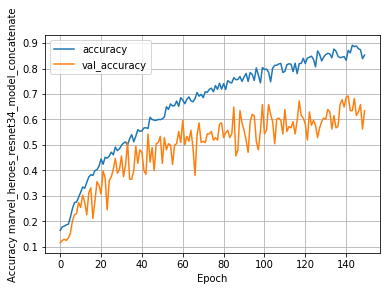

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy marvel_heroes_resnet34_model_concatenate')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
145,0.337290,0.888559,1.319403,0.615385,145
146,0.350342,0.878157,1.358316,0.629808,146
147,0.379101,0.873700,1.134449,0.658654,147
148,0.478147,0.838782,1.562864,0.562500,148
149,0.415723,0.852897,1.360950,0.634615,149


### ResNet34_V2 (skip connection: Concatenate)

In [ ]:
build_resnet34_v2 = BuildResNet34_v2()
resnet34_v2_model_concatenate = build_resnet34_v2.build_model(is_skip_connection=True, classes=8, method='concatenate')

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = resnet34_v2_model_concatenate(x)
marvel_heroes_resnet34_v2_model_concatenate = Model(inputs=image_input, outputs=x)

marvel_heroes_resnet34_v2_model_concatenate.summary()

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_14 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 sequential_1 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 model_11 (Functional)       (None, 8)                 23849160  
                                                                 
Total params: 23,849,160
Trainable params: 23,817,928
Non-trainable params: 31,232
_________________________________________________________________


In [ ]:
marvel_heroes_resnet34_v2_model_concatenate.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 150

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_concatenate.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)

history = marvel_heroes_resnet34_v2_model_concatenate.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/150
42/43 [============================>.] - ETA: 0s - loss: 2.1539 - accuracy: 0.1406
Epoch 00001: val_accuracy improved from -inf to 0.13462, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_concatenate.h5
43/43 [==============================] - 5s 85ms/step - loss: 2.1536 - accuracy: 0.1404 - val_loss: 2.1053 - val_accuracy: 0.1346
Epoch 2/150
42/43 [============================>.] - ETA: 0s - loss: 2.0649 - accuracy: 0.1600
Epoch 00002: val_accuracy did not improve from 0.13462
43/43 [==============================] - 3s 73ms/step - loss: 2.0642 - accuracy: 0.1605 - val_loss: 2.2172 - val_accuracy: 0.1346
Epoch 3/150
42/43 [============================>.] - ETA: 0s - loss: 2.0548 - accuracy: 0.1749
Epoch 00003: val_accuracy did not improve from 0.13462
43/43 [==============================] - 3s 74ms/step - loss: 2.0550 - accuracy: 0.1746 - val_loss: 2.4072 - val_accuracy: 0.1346
Epoch 4/150
42/43 [============================>.

42/43 [============================>.] - ETA: 0s - loss: 1.5272 - accuracy: 0.4286
Epoch 00025: val_accuracy did not improve from 0.38942
43/43 [==============================] - 3s 73ms/step - loss: 1.5268 - accuracy: 0.4287 - val_loss: 1.6296 - val_accuracy: 0.3510
Epoch 26/150
42/43 [============================>.] - ETA: 0s - loss: 1.5206 - accuracy: 0.4278
Epoch 00026: val_accuracy improved from 0.38942 to 0.42308, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_concatenate.h5
43/43 [==============================] - 4s 88ms/step - loss: 1.5218 - accuracy: 0.4272 - val_loss: 1.6452 - val_accuracy: 0.4231
Epoch 27/150
42/43 [============================>.] - ETA: 0s - loss: 1.4825 - accuracy: 0.4554
Epoch 00027: val_accuracy did not improve from 0.42308
43/43 [==============================] - 3s 73ms/step - loss: 1.4824 - accuracy: 0.4554 - val_loss: 1.7169 - val_accuracy: 0.3894
Epoch 28/150
42/43 [============================>.] - ET

Epoch 52/150
42/43 [============================>.] - ETA: 0s - loss: 1.0907 - accuracy: 0.6235
Epoch 00052: val_accuracy did not improve from 0.55769
43/43 [==============================] - 3s 72ms/step - loss: 1.0933 - accuracy: 0.6226 - val_loss: 1.8165 - val_accuracy: 0.4183
Epoch 53/150
42/43 [============================>.] - ETA: 0s - loss: 1.1519 - accuracy: 0.5967
Epoch 00053: val_accuracy did not improve from 0.55769
43/43 [==============================] - 3s 73ms/step - loss: 1.1542 - accuracy: 0.5958 - val_loss: 1.6415 - val_accuracy: 0.4519
Epoch 54/150
42/43 [============================>.] - ETA: 0s - loss: 1.0849 - accuracy: 0.6228
Epoch 00054: val_accuracy did not improve from 0.55769
43/43 [==============================] - 3s 72ms/step - loss: 1.0871 - accuracy: 0.6218 - val_loss: 1.3923 - val_accuracy: 0.5144
Epoch 55/150
42/43 [============================>.] - ETA: 0s - loss: 1.0902 - accuracy: 0.6205
Epoch 00055: val_accuracy did not improve from 0.55769
43/43 

Epoch 80/150
42/43 [============================>.] - ETA: 0s - loss: 0.7986 - accuracy: 0.7106
Epoch 00080: val_accuracy did not improve from 0.59135
43/43 [==============================] - 3s 73ms/step - loss: 0.7986 - accuracy: 0.7110 - val_loss: 1.4971 - val_accuracy: 0.5337
Epoch 81/150
42/43 [============================>.] - ETA: 0s - loss: 0.7438 - accuracy: 0.7388
Epoch 00081: val_accuracy did not improve from 0.59135
43/43 [==============================] - 3s 73ms/step - loss: 0.7472 - accuracy: 0.7377 - val_loss: 1.3506 - val_accuracy: 0.5865
Epoch 82/150
42/43 [============================>.] - ETA: 0s - loss: 0.8212 - accuracy: 0.7113
Epoch 00082: val_accuracy did not improve from 0.59135
43/43 [==============================] - 3s 72ms/step - loss: 0.8210 - accuracy: 0.7117 - val_loss: 1.9152 - val_accuracy: 0.4760
Epoch 83/150
42/43 [============================>.] - ETA: 0s - loss: 0.7764 - accuracy: 0.7202
Epoch 00083: val_accuracy did not improve from 0.59135
43/43 

Epoch 108/150
42/43 [============================>.] - ETA: 0s - loss: 0.5872 - accuracy: 0.7999
Epoch 00108: val_accuracy improved from 0.62981 to 0.65385, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_resnet34_v2_model_concatenate.h5
43/43 [==============================] - 4s 86ms/step - loss: 0.5902 - accuracy: 0.7994 - val_loss: 1.3489 - val_accuracy: 0.6538
Epoch 109/150
42/43 [============================>.] - ETA: 0s - loss: 0.7026 - accuracy: 0.7500
Epoch 00109: val_accuracy did not improve from 0.65385
43/43 [==============================] - 3s 72ms/step - loss: 0.7049 - accuracy: 0.7489 - val_loss: 1.4182 - val_accuracy: 0.6106
Epoch 110/150
42/43 [============================>.] - ETA: 0s - loss: 0.5577 - accuracy: 0.8095
Epoch 00110: val_accuracy did not improve from 0.65385
43/43 [==============================] - 3s 73ms/step - loss: 0.5597 - accuracy: 0.8091 - val_loss: 1.3275 - val_accuracy: 0.6202
Epoch 111/150
42/43 [===================

42/43 [============================>.] - ETA: 0s - loss: 0.3994 - accuracy: 0.8638
Epoch 00136: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 73ms/step - loss: 0.4008 - accuracy: 0.8626 - val_loss: 1.2777 - val_accuracy: 0.6250
Epoch 137/150
42/43 [============================>.] - ETA: 0s - loss: 0.3777 - accuracy: 0.8795
Epoch 00137: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 72ms/step - loss: 0.3828 - accuracy: 0.8782 - val_loss: 1.2392 - val_accuracy: 0.6538
Epoch 138/150
42/43 [============================>.] - ETA: 0s - loss: 0.4499 - accuracy: 0.8423
Epoch 00138: val_accuracy did not improve from 0.65865
43/43 [==============================] - 3s 73ms/step - loss: 0.4539 - accuracy: 0.8410 - val_loss: 1.3987 - val_accuracy: 0.6587
Epoch 139/150
42/43 [============================>.] - ETA: 0s - loss: 0.3407 - accuracy: 0.8891
Epoch 00139: val_accuracy did not improve from 0.65865
43/43 [=========

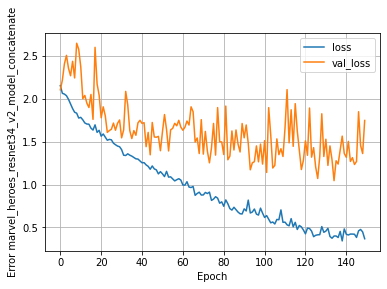

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error marvel_heroes_resnet34_v2_model_concatenate')
plt.legend()
plt.grid(True)

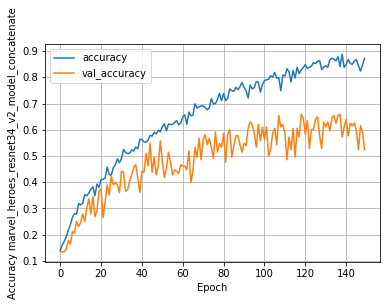

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy marvel_heroes_resnet34_v2_model_concatenate')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
145,0.383879,0.867756,1.269842,0.596154,145
146,0.460624,0.843982,1.849422,0.524038,146
147,0.476903,0.823923,1.455408,0.615385,147
148,0.448046,0.847697,1.362064,0.591346,148
149,0.368605,0.872214,1.747269,0.524038,149


###  Densenet121 (skip connection: Concatenate)

In [ ]:
build_densenet121 = BuildDensenet121()
densenet121_model_concatenate = build_densenet121.build_model(is_skip_connection=True, classes=8, method='concatenate')

image_input = layers.Input(shape=(img_height,img_width,3))
x = data_augmentation(image_input)
x = densenet121_model_concatenate(x)
marvel_heroes_densenet121_model_concatenate = Model(inputs=image_input, outputs=x)

marvel_heroes_densenet121_model_concatenate.summary()

Model: "model_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 sequential_1 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 model_13 (Functional)       (None, 8)                 7045704   
                                                                 
Total params: 7,045,704
Trainable params: 6,962,056
Non-trainable params: 83,648
_________________________________________________________________


In [ ]:
marvel_heroes_densenet121_model_concatenate.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(), 
                      metrics=['accuracy'])


In [ ]:
num_epochs = 150

checkpoint_path = "/media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_concatenate.h5"
os.makedirs("/media/aivn24/partition1/Khoa/CNN2/save_model", exist_ok=True)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_path,
            verbose=1,
            save_weights_only=True,
            monitor='val_accuracy',
            mode='max',
            save_best_only=True)

history = marvel_heroes_densenet121_model_concatenate.fit(train_ds,
                                epochs = num_epochs,
                                validation_data = val_ds,
                                callbacks=[model_checkpoint])

Epoch 1/150
42/43 [============================>.] - ETA: 0s - loss: 1.9754 - accuracy: 0.2664
Epoch 00001: val_accuracy improved from -inf to 0.19231, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_concatenate.h5
43/43 [==============================] - 9s 132ms/step - loss: 1.9758 - accuracy: 0.2667 - val_loss: 2.0670 - val_accuracy: 0.1923
Epoch 2/150
42/43 [============================>.] - ETA: 0s - loss: 1.7300 - accuracy: 0.3735
Epoch 00002: val_accuracy improved from 0.19231 to 0.25481, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_concatenate.h5
43/43 [==============================] - 5s 122ms/step - loss: 1.7297 - accuracy: 0.3744 - val_loss: 2.0212 - val_accuracy: 0.2548
Epoch 3/150
42/43 [============================>.] - ETA: 0s - loss: 1.5838 - accuracy: 0.4405
Epoch 00003: val_accuracy improved from 0.25481 to 0.33173, saving model to /media/aivn24/partition1/Khoa/CNN2/save_mo

42/43 [============================>.] - ETA: 0s - loss: 0.6587 - accuracy: 0.7664
Epoch 00026: val_accuracy did not improve from 0.55769
43/43 [==============================] - 5s 117ms/step - loss: 0.6608 - accuracy: 0.7652 - val_loss: 2.0445 - val_accuracy: 0.4471
Epoch 27/150
42/43 [============================>.] - ETA: 0s - loss: 0.6986 - accuracy: 0.7716
Epoch 00027: val_accuracy did not improve from 0.55769
43/43 [==============================] - 5s 117ms/step - loss: 0.6987 - accuracy: 0.7712 - val_loss: 1.6601 - val_accuracy: 0.5048
Epoch 28/150
42/43 [============================>.] - ETA: 0s - loss: 0.6181 - accuracy: 0.7976
Epoch 00028: val_accuracy did not improve from 0.55769
43/43 [==============================] - 5s 118ms/step - loss: 0.6215 - accuracy: 0.7964 - val_loss: 1.5240 - val_accuracy: 0.5000
Epoch 29/150
42/43 [============================>.] - ETA: 0s - loss: 0.6841 - accuracy: 0.7634
Epoch 00029: val_accuracy did not improve from 0.55769
43/43 [=========

42/43 [============================>.] - ETA: 0s - loss: 0.3175 - accuracy: 0.8951
Epoch 00054: val_accuracy improved from 0.60096 to 0.63942, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_concatenate.h5
43/43 [==============================] - 5s 122ms/step - loss: 0.3205 - accuracy: 0.8938 - val_loss: 1.2516 - val_accuracy: 0.6394
Epoch 55/150
42/43 [============================>.] - ETA: 0s - loss: 0.2877 - accuracy: 0.9040
Epoch 00055: val_accuracy did not improve from 0.63942
43/43 [==============================] - 5s 116ms/step - loss: 0.2929 - accuracy: 0.9027 - val_loss: 1.5567 - val_accuracy: 0.5865
Epoch 56/150
42/43 [============================>.] - ETA: 0s - loss: 0.3395 - accuracy: 0.8884
Epoch 00056: val_accuracy did not improve from 0.63942
43/43 [==============================] - 5s 117ms/step - loss: 0.3403 - accuracy: 0.8878 - val_loss: 1.5631 - val_accuracy: 0.5288
Epoch 57/150
42/43 [============================>.] -

Epoch 82/150
42/43 [============================>.] - ETA: 0s - loss: 0.3149 - accuracy: 0.8988
Epoch 00082: val_accuracy did not improve from 0.68269
43/43 [==============================] - 5s 118ms/step - loss: 0.3152 - accuracy: 0.8990 - val_loss: 1.4222 - val_accuracy: 0.5962
Epoch 83/150
42/43 [============================>.] - ETA: 0s - loss: 0.2432 - accuracy: 0.9241
Epoch 00083: val_accuracy did not improve from 0.68269
43/43 [==============================] - 5s 118ms/step - loss: 0.2442 - accuracy: 0.9235 - val_loss: 1.1937 - val_accuracy: 0.6490
Epoch 84/150
42/43 [============================>.] - ETA: 0s - loss: 0.1863 - accuracy: 0.9420
Epoch 00084: val_accuracy did not improve from 0.68269
43/43 [==============================] - 5s 118ms/step - loss: 0.1872 - accuracy: 0.9413 - val_loss: 1.4643 - val_accuracy: 0.6250
Epoch 85/150
42/43 [============================>.] - ETA: 0s - loss: 0.1891 - accuracy: 0.9368
Epoch 00085: val_accuracy did not improve from 0.68269
43/

42/43 [============================>.] - ETA: 0s - loss: 0.1465 - accuracy: 0.9546
Epoch 00111: val_accuracy did not improve from 0.68269
43/43 [==============================] - 5s 118ms/step - loss: 0.1492 - accuracy: 0.9532 - val_loss: 1.7675 - val_accuracy: 0.5913
Epoch 112/150
42/43 [============================>.] - ETA: 0s - loss: 0.1701 - accuracy: 0.9427
Epoch 00112: val_accuracy did not improve from 0.68269
43/43 [==============================] - 5s 118ms/step - loss: 0.1711 - accuracy: 0.9421 - val_loss: 1.7183 - val_accuracy: 0.6154
Epoch 113/150
42/43 [============================>.] - ETA: 0s - loss: 0.2028 - accuracy: 0.9345
Epoch 00113: val_accuracy did not improve from 0.68269
43/43 [==============================] - 5s 118ms/step - loss: 0.2073 - accuracy: 0.9331 - val_loss: 1.4486 - val_accuracy: 0.6490
Epoch 114/150
42/43 [============================>.] - ETA: 0s - loss: 0.1623 - accuracy: 0.9539
Epoch 00114: val_accuracy did not improve from 0.68269
43/43 [======

Epoch 139/150
42/43 [============================>.] - ETA: 0s - loss: 0.1502 - accuracy: 0.9576
Epoch 00139: val_accuracy did not improve from 0.71635
43/43 [==============================] - 5s 118ms/step - loss: 0.1509 - accuracy: 0.9569 - val_loss: 1.8870 - val_accuracy: 0.5769
Epoch 140/150
42/43 [============================>.] - ETA: 0s - loss: 0.1254 - accuracy: 0.9576
Epoch 00140: val_accuracy improved from 0.71635 to 0.72596, saving model to /media/aivn24/partition1/Khoa/CNN2/save_model/marvel_heroes_densenet121_model_concatenate.h5
43/43 [==============================] - 6s 123ms/step - loss: 0.1254 - accuracy: 0.9577 - val_loss: 1.0020 - val_accuracy: 0.7260
Epoch 141/150
42/43 [============================>.] - ETA: 0s - loss: 0.1080 - accuracy: 0.9635
Epoch 00141: val_accuracy did not improve from 0.72596
43/43 [==============================] - 5s 117ms/step - loss: 0.1085 - accuracy: 0.9636 - val_loss: 1.3350 - val_accuracy: 0.7067
Epoch 142/150
42/43 [================

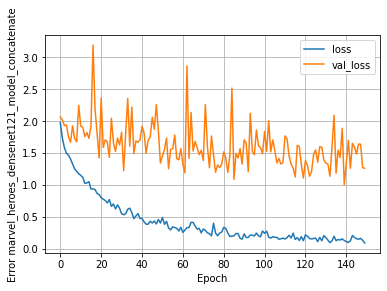

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Error marvel_heroes_densenet121_model_concatenate')
plt.legend()
plt.grid(True)

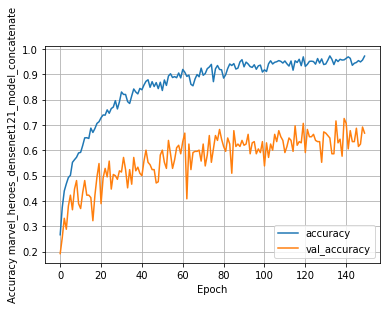

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy marvel_heroes_densenet121_model_concatenate')
plt.legend()
plt.grid(True)

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,accuracy,val_loss,val_accuracy,epoch
145,0.153279,0.947251,1.483570,0.687500,145
146,0.146040,0.954681,1.638992,0.615385,146
147,0.158647,0.949480,1.637409,0.625000,147
148,0.128589,0.956909,1.269587,0.692308,148
149,0.087704,0.972511,1.258792,0.668269,149


## Problem10: Inpainting Image with UNET

### Unet Model

In [ ]:
class BuildUnet():
    def __init__(self):
        self.down_filters = [64, 128, 256, 512]
        self.up_filters = [512, 256, 128, 64]
    
    def extract_first_features(self, inputs, filters):
        x = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', 
                          kernel_initializer='he_normal', use_bias=False)(inputs)
        x = layers.LeakyReLU()(x)
        
        return x
    
    
    def DoubleConv2D(self, inputs, filters):
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', 
                          kernel_initializer='he_normal', use_bias=False)(inputs)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', 
                          kernel_initializer='he_normal', use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        
        return x
    
    
    def downsample(self, inputs, filters):
        bdown = self.DoubleConv2D(inputs, filters)
        x = layers.MaxPooling2D(pool_size=(2,2), strides=2)(bdown)
        
        return x, bdown
    
    
    def upsample(self, inputs1, inputs2, filters):
        inputs1 = layers.UpSampling2D(interpolation='bilinear')(inputs1)
        inputs1 = layers.Conv2D(filters=filters, kernel_size=(1,1),
                                kernel_initializer='he_normal', use_bias=False)(inputs1)
        inputs1 = layers.BatchNormalization()(inputs1)
        inputs1 = layers.LeakyReLU()(inputs1)
        x = layers.Concatenate()([inputs1, inputs2])
        x = self.DoubleConv2D(x, filters)
        
        return x

    
    def build_model(self, input_shape=(256,256,3)):
        inputs = layers.Input(shape=input_shape)
        x = self.extract_first_features(inputs, filters=64)
        
        # Downsampling through the model
        skips = []
        for df in self.down_filters:
            x, bdown = self.downsample(x, filters=df)
            skips.append(bdown)
        
        # Mid
        x = self.DoubleConv2D(x, filters=1024)
        
        # Upsampling and establishing the skip connections
        skips = reversed(skips)
        for uf, skip in zip(self.up_filters, skips):
            x = self.upsample(x, skip, filters=uf)
        
        # Final
        outputs = layers.Conv2D(filters=input_shape[-1], kernel_size=(1,1), activation='tanh',
                                      kernel_initializer='he_normal', use_bias=False)(x)
            
        model = Model(inputs=[inputs], outputs=[outputs])
        
        return model
        
        
        
        

In [ ]:
build_unet = BuildUnet()
unet_model = build_unet.build_model()

In [ ]:
unet_model.summary()

Model: "model_20"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_22 (InputLayer)          [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_696 (Conv2D)            (None, 256, 256, 64  192         ['input_22[0][0]']               
                                )                                                                 
                                                                                                  
 leaky_re_lu_69 (LeakyReLU)     (None, 256, 256, 64  0           ['conv2d_696[0][0]']             
                                )                                                          

### Prepare Inpainting Dataset

In [ ]:
LHR_TRAIN_DATA_PATH = '/media/aivn24/partition1/Khoa/CNN2/K_LHR_image/K_LHR_image/train'
LHR_VAL_DATA_PATH = '/media/aivn24/partition1/Khoa/CNN2/K_LHR_image/K_LHR_image/val'


BATCH_SIZE  = 8
BUFFER_SIZE = BATCH_SIZE*10
IMG_WIDTH   = 256
IMG_HEIGHT  = 256

def create_mask(image):
    masked_image = tf.identity(image)
    ## Prepare masking matrix
    mask = np.full((IMG_WIDTH,IMG_HEIGHT,3), 0, np.uint8)
    for _ in range(np.random.randint(1, 15)):
      # Get random x locations to start line
      x1, x2 = np.random.randint(1, IMG_WIDTH), np.random.randint(1, IMG_WIDTH)
      # Get random y locations to start line
      y1, y2 = np.random.randint(1, IMG_HEIGHT), np.random.randint(1, IMG_HEIGHT)
      # Get random thickness of the line drawn
      thickness = np.random.randint(1, 15)
      # Draw black line on the black mask
      cv2.line(mask,(x1,y1),(x2,y2),(255,255,255),thickness)

    # Perforn bitwise and operation to mak the image
#     masked_image = cv2.bitwise_and(img, mask)
    masked_image = tf.bitwise.bitwise_or(masked_image, mask)
    masked_image = tf.convert_to_tensor(masked_image)
    masked_image = tf.cast(masked_image, tf.float32)
    return masked_image

def tf_function(image):
    masked_image = tf.numpy_function(create_mask, [image], tf.float32)
    return masked_image


def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image,channels=3)
        
    input_image  = tf_function(image)
    target_image = image
    
    input_image  = tf.cast(input_image, tf.float32)
    target_image = tf.cast(target_image, tf.float32)

    return input_image, target_image

(256, 256, 3)
(256, 256, 3)


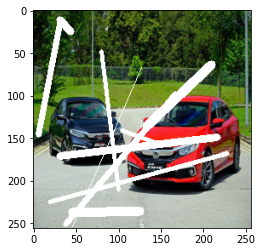

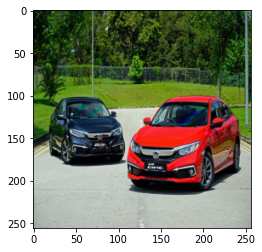

In [ ]:
input_image, target_image = load(LHR_TRAIN_DATA_PATH+'/0.png')
print(input_image.shape)
print(target_image.shape)


# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(input_image/255.0)
plt.figure()
plt.imshow(target_image/255.0)

In [ ]:
# normalizing the images to [-1, 1]
def normalize(input_image, target_image):
    input_image  = (input_image / 127.5) - 1
    target_image = (target_image / 127.5) - 1

    return input_image, target_image


def load_image_train(image_file):
    input_image, target_image = load(image_file)
    input_image, target_image = normalize(input_image, target_image)

    return input_image, target_image

def load_image_test(image_file):
    input_image, target_image = load(image_file)
    input_image, target_image = normalize(input_image, target_image)

    return input_image, target_image

In [ ]:
# train_dataset
train_dataset = tf.data.Dataset.list_files(LHR_TRAIN_DATA_PATH + '/*.png')
train_dataset = train_dataset.map(load_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(1)

# test_dataset
test_dataset = tf.data.Dataset.list_files(LHR_VAL_DATA_PATH + '/*.png')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(1)

In [ ]:
def generator_loss(fake, target):
    l1_loss = tf.reduce_mean(tf.abs(fake-target))
    
    return l1_loss

In [ ]:
def evaluate(model, epoch):  
    psnr_mean = 0.0
    count = 0
    for inputs, targets in test_dataset:
        fake = model([inputs], training=True)
         
        psnr = tf.image.psnr(fake*0.5 + 0.5, targets*0.5 + 0.5, max_val=1.0)

        __psnr_mean = tf.math.reduce_mean(psnr)
        # psnr_mean = psnr_mean_l
        
        psnr_mean += __psnr_mean
        count =count + 1
    
    psnr_mean = psnr_mean/count
    print('-------- psnr: ', psnr_mean.numpy(), '   ----- epoch: ', epoch, '  count: ', count)
    
    return psnr_mean
    
def generate_images(model, inputs, targets):
    fake = model([inputs], training=True)
    plt.figure(figsize=(15,20))
    
    display_list = [inputs[0], targets[0], fake[0]]
    title = ['Input', 'Real', 'Predicted']    

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()        

### Train

In [ ]:
build_unet = BuildUnet()
unet_model = build_unet.build_model()

# image_input = layers.Input(shape=(IMG_HEIGHT,IMG_WIDTH,3))
# x = tf.keras.layers.Resizing(height=IMG_HEIGHT, width=IMG_WIDTH)(image_input)
# x = unet_model(x)
# Inp_unet_model= Model(inputs=image_input, outputs=x)
Inp_unet_model = unet_model
Inp_unet_model.summary()

Model: "model_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_28 (InputLayer)       [(None, 256, 256, 3)]     0         
                                                                 
 resizing_4 (Resizing)       (None, 256, 256, 3)       0         
                                                                 
 model_25 (Functional)       (None, 256, 256, 3)       28998784  
                                                                 
Total params: 28,998,784
Trainable params: 28,985,088
Non-trainable params: 13,696
_________________________________________________________________


In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

@tf.function
def train_step(inputs, targets):
    with tf.GradientTape() as tape:
        # output
        fake = Inp_unet_model([inputs], training=True)     
        loss = generator_loss(fake, targets)
        

    generator_gradients = tape.gradient(loss, Inp_unet_model.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, Inp_unet_model.trainable_variables))
    
    return loss

    
    
def fit(train_ds, epochs, test_ds):
    best_pnsr = 0.0
    for epoch in range(epochs):
        # Train
        total_loss = 0.0
        for inputs, targets in train_ds:
            loss = train_step(inputs, targets)
            total_loss = total_loss + loss
        total_loss = total_loss/400
        print('epoch: {}   loss: {}'.format(epoch, total_loss))
        
        pnsr = evaluate(Inp_unet_model, epoch)        
        if best_pnsr < pnsr:
            best_pnsr = pnsr
            
            for inputs, targets in test_ds.take(1):
                generate_images(Inp_unet_model, inputs, targets)


epoch: 0   loss: 0.4152284562587738
-------- psnr:  17.264893    ----- epoch:  0   count:  170


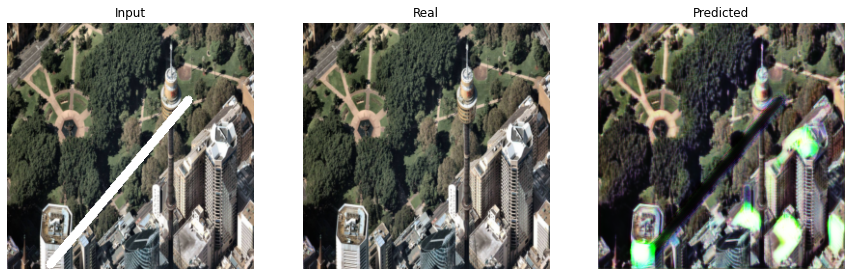

epoch: 1   loss: 0.2904791533946991
-------- psnr:  18.507664    ----- epoch:  1   count:  170


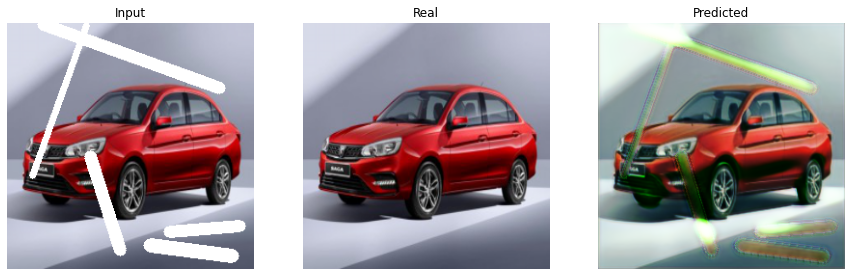

epoch: 2   loss: 0.25173619389533997
-------- psnr:  19.48275    ----- epoch:  2   count:  170


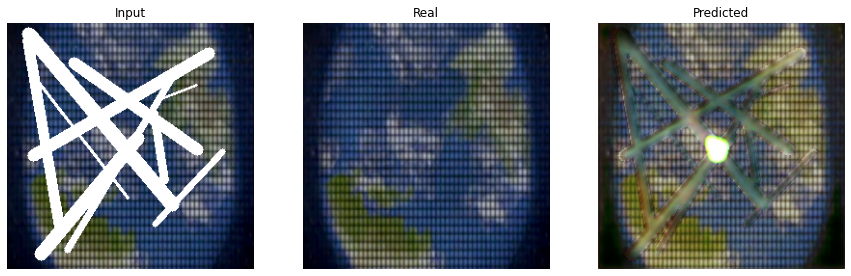

epoch: 3   loss: 0.23139433562755585
-------- psnr:  20.483461    ----- epoch:  3   count:  170


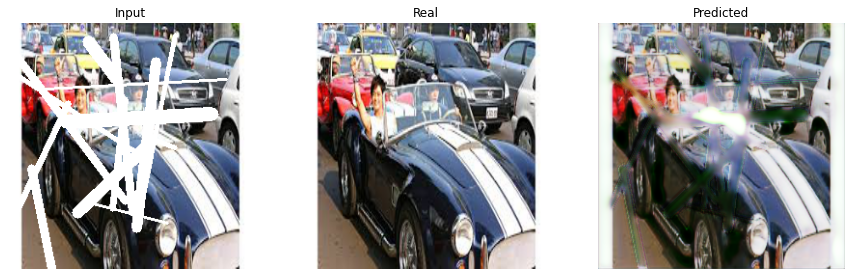

epoch: 4   loss: 0.21084126830101013
-------- psnr:  20.785187    ----- epoch:  4   count:  170


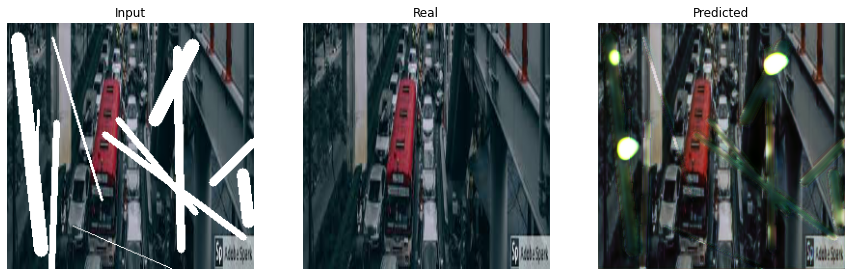

epoch: 5   loss: 0.2027108371257782
-------- psnr:  21.06789    ----- epoch:  5   count:  170


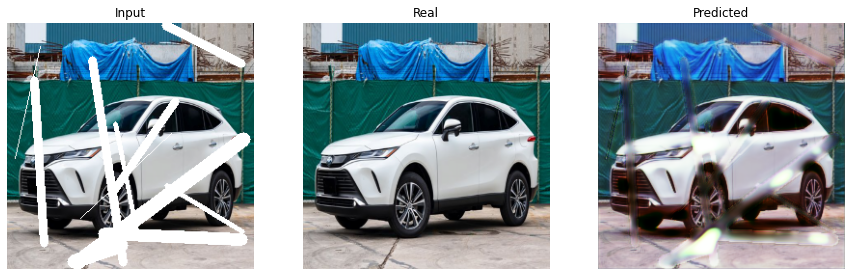

epoch: 6   loss: 0.1892717331647873
-------- psnr:  21.10892    ----- epoch:  6   count:  170


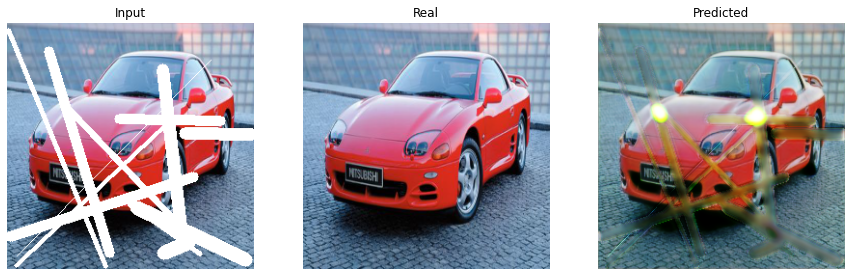

epoch: 7   loss: 0.17993497848510742
-------- psnr:  22.218185    ----- epoch:  7   count:  170


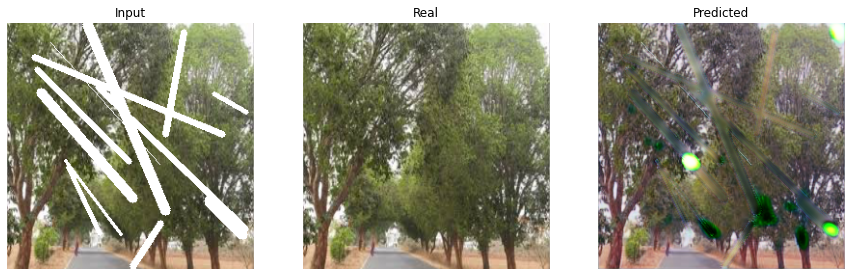

epoch: 8   loss: 0.17339277267456055
-------- psnr:  22.094265    ----- epoch:  8   count:  170
epoch: 9   loss: 0.1648251861333847
-------- psnr:  22.1829    ----- epoch:  9   count:  170
epoch: 10   loss: 0.1611066311597824
-------- psnr:  22.571287    ----- epoch:  10   count:  170


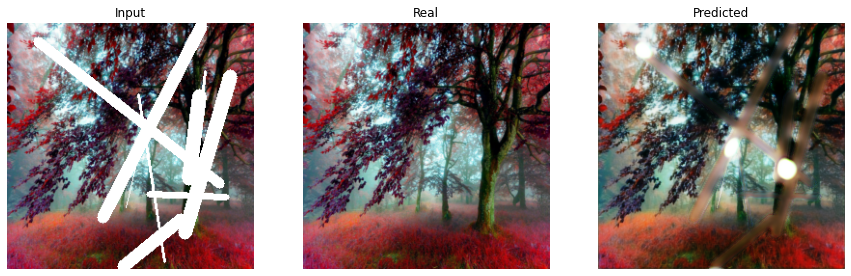

epoch: 11   loss: 0.15338300168514252
-------- psnr:  23.1366    ----- epoch:  11   count:  170


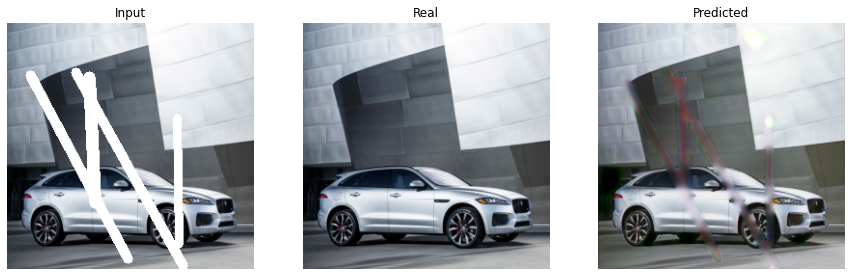

epoch: 12   loss: 0.15336212515830994
-------- psnr:  22.805767    ----- epoch:  12   count:  170
epoch: 13   loss: 0.1469707489013672
-------- psnr:  23.382397    ----- epoch:  13   count:  170


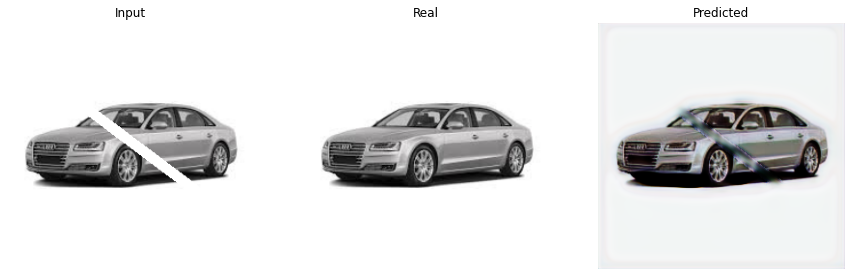

epoch: 14   loss: 0.14296019077301025
-------- psnr:  23.682865    ----- epoch:  14   count:  170


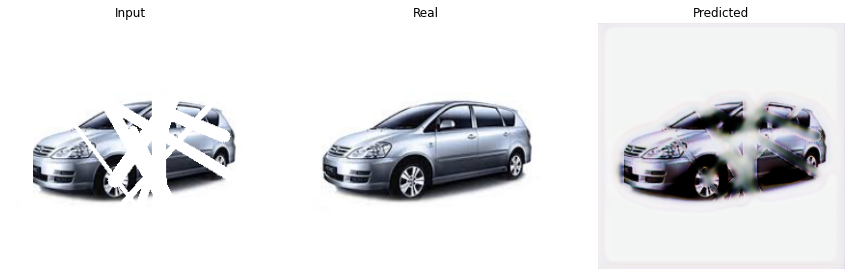

epoch: 15   loss: 0.14127828180789948
-------- psnr:  23.61994    ----- epoch:  15   count:  170
epoch: 16   loss: 0.13697127997875214
-------- psnr:  23.580494    ----- epoch:  16   count:  170
epoch: 17   loss: 0.13675624132156372
-------- psnr:  23.053633    ----- epoch:  17   count:  170
epoch: 18   loss: 0.13984163105487823
-------- psnr:  22.481142    ----- epoch:  18   count:  170
epoch: 19   loss: 0.13274040818214417
-------- psnr:  23.587036    ----- epoch:  19   count:  170
epoch: 20   loss: 0.12913045287132263
-------- psnr:  23.996702    ----- epoch:  20   count:  170


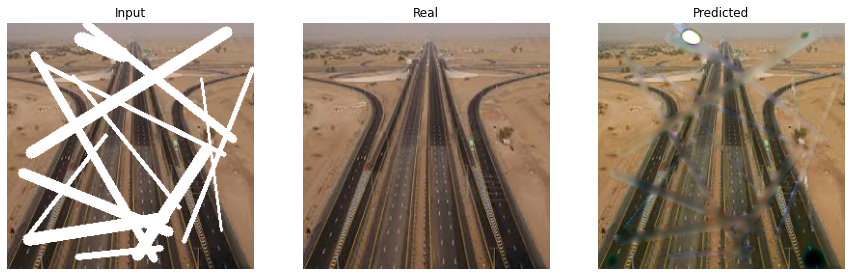

epoch: 21   loss: 0.1283448338508606
-------- psnr:  23.492537    ----- epoch:  21   count:  170
epoch: 22   loss: 0.12802284955978394
-------- psnr:  24.174726    ----- epoch:  22   count:  170


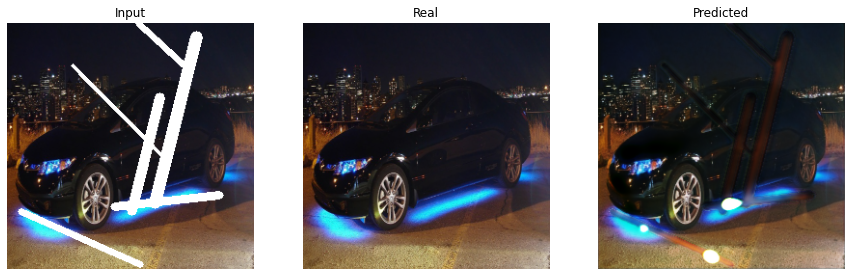

epoch: 23   loss: 0.12524324655532837
-------- psnr:  23.974274    ----- epoch:  23   count:  170
epoch: 24   loss: 0.12295027822256088
-------- psnr:  24.477203    ----- epoch:  24   count:  170


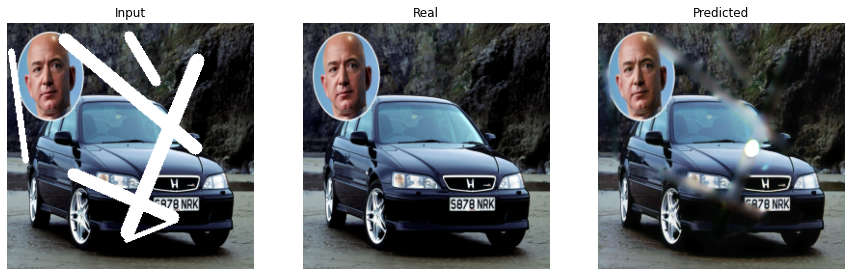

epoch: 25   loss: 0.12388323992490768
-------- psnr:  24.48933    ----- epoch:  25   count:  170


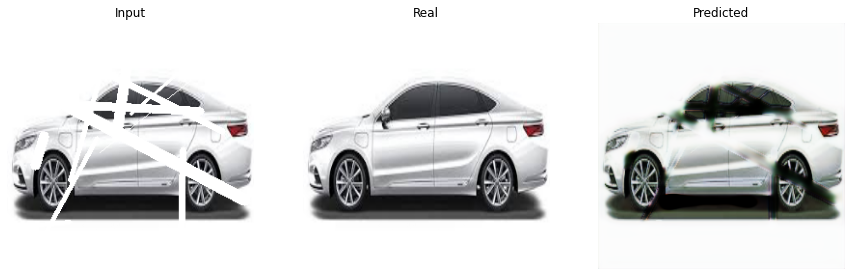

epoch: 26   loss: 0.11974965035915375
-------- psnr:  24.243994    ----- epoch:  26   count:  170
epoch: 27   loss: 0.11981949210166931
-------- psnr:  24.371061    ----- epoch:  27   count:  170
epoch: 28   loss: 0.11926668137311935
-------- psnr:  24.18162    ----- epoch:  28   count:  170
epoch: 29   loss: 0.11540478467941284
-------- psnr:  24.970636    ----- epoch:  29   count:  170


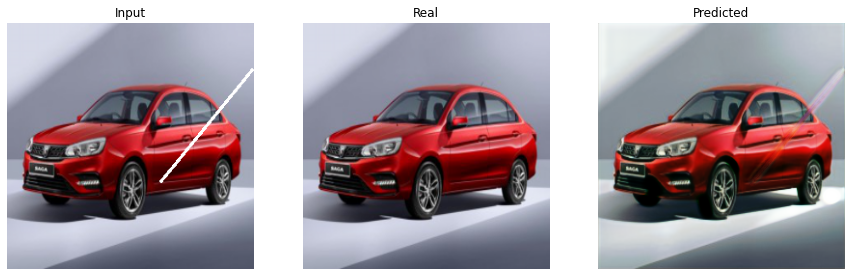

epoch: 30   loss: 0.11700520664453506
-------- psnr:  24.98696    ----- epoch:  30   count:  170


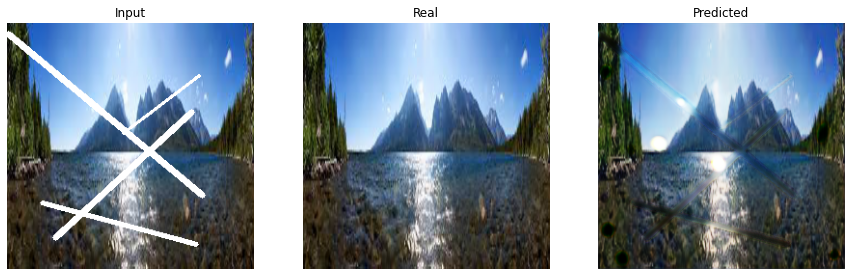

epoch: 31   loss: 0.1127440556883812
-------- psnr:  24.862326    ----- epoch:  31   count:  170
epoch: 32   loss: 0.11384745687246323
-------- psnr:  24.86319    ----- epoch:  32   count:  170
epoch: 33   loss: 0.11007623374462128
-------- psnr:  24.609892    ----- epoch:  33   count:  170
epoch: 34   loss: 0.11082921177148819
-------- psnr:  24.621843    ----- epoch:  34   count:  170
epoch: 35   loss: 0.11115693300962448
-------- psnr:  25.018442    ----- epoch:  35   count:  170


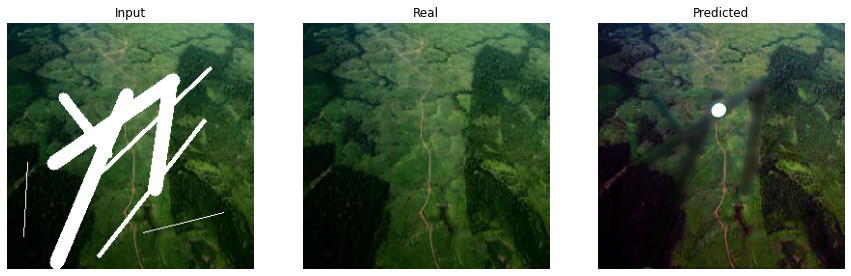

epoch: 36   loss: 0.10613656044006348
-------- psnr:  25.431652    ----- epoch:  36   count:  170


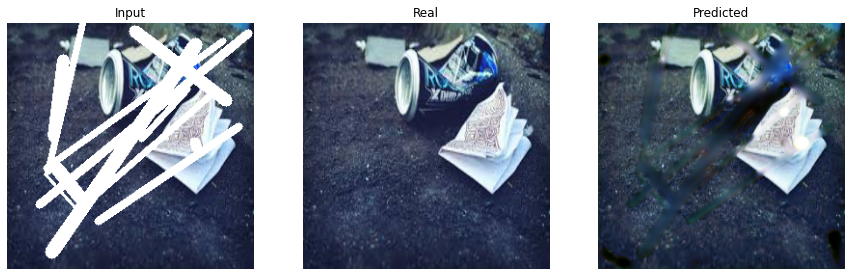

epoch: 37   loss: 0.10751057416200638
-------- psnr:  25.369596    ----- epoch:  37   count:  170
epoch: 38   loss: 0.10623349994421005
-------- psnr:  24.443071    ----- epoch:  38   count:  170
epoch: 39   loss: 0.10549307614564896
-------- psnr:  25.348032    ----- epoch:  39   count:  170
epoch: 40   loss: 0.10369674861431122
-------- psnr:  24.735523    ----- epoch:  40   count:  170
epoch: 41   loss: 0.10421163588762283
-------- psnr:  25.10799    ----- epoch:  41   count:  170
epoch: 42   loss: 0.10361184179782867
-------- psnr:  24.890053    ----- epoch:  42   count:  170
epoch: 43   loss: 0.10106933861970901
-------- psnr:  24.677298    ----- epoch:  43   count:  170
epoch: 44   loss: 0.10207942873239517
-------- psnr:  25.378532    ----- epoch:  44   count:  170
epoch: 45   loss: 0.10362924635410309
-------- psnr:  25.262587    ----- epoch:  45   count:  170
epoch: 46   loss: 0.10287626087665558
-------- psnr:  25.782318    ----- epoch:  46   count:  170


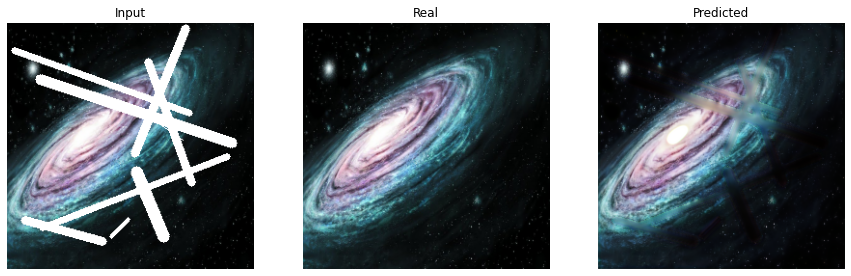

epoch: 47   loss: 0.09889890998601913
-------- psnr:  25.611784    ----- epoch:  47   count:  170
epoch: 48   loss: 0.09954214841127396
-------- psnr:  25.396173    ----- epoch:  48   count:  170
epoch: 49   loss: 0.09742431342601776
-------- psnr:  24.946709    ----- epoch:  49   count:  170
epoch: 50   loss: 0.09557625651359558
-------- psnr:  25.746048    ----- epoch:  50   count:  170
epoch: 51   loss: 0.09790614992380142
-------- psnr:  25.51539    ----- epoch:  51   count:  170
epoch: 52   loss: 0.09590613096952438
-------- psnr:  25.612772    ----- epoch:  52   count:  170
epoch: 53   loss: 0.09382999688386917
-------- psnr:  26.2561    ----- epoch:  53   count:  170


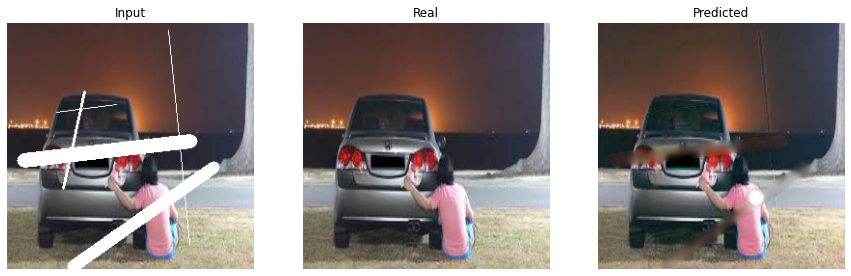

epoch: 54   loss: 0.09418170154094696
-------- psnr:  25.711256    ----- epoch:  54   count:  170
epoch: 55   loss: 0.0955561175942421
-------- psnr:  25.727577    ----- epoch:  55   count:  170
epoch: 56   loss: 0.09441924840211868
-------- psnr:  25.86609    ----- epoch:  56   count:  170
epoch: 57   loss: 0.09329013526439667
-------- psnr:  25.80351    ----- epoch:  57   count:  170
epoch: 58   loss: 0.09279678016901016
-------- psnr:  25.906052    ----- epoch:  58   count:  170
epoch: 59   loss: 0.09307054430246353
-------- psnr:  25.84838    ----- epoch:  59   count:  170
epoch: 60   loss: 0.08987630158662796
-------- psnr:  25.937437    ----- epoch:  60   count:  170
epoch: 61   loss: 0.09081779420375824
-------- psnr:  25.858955    ----- epoch:  61   count:  170
epoch: 62   loss: 0.09125849604606628
-------- psnr:  26.068548    ----- epoch:  62   count:  170
epoch: 63   loss: 0.09409406036138535
-------- psnr:  26.031954    ----- epoch:  63   count:  170
epoch: 64   loss: 0.0919

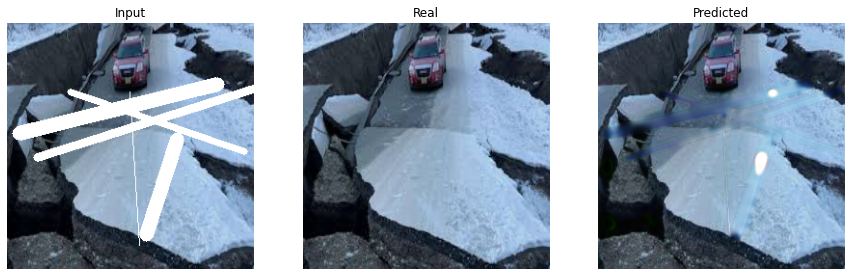

epoch: 66   loss: 0.0881313607096672
-------- psnr:  25.890648    ----- epoch:  66   count:  170
epoch: 67   loss: 0.08961998671293259
-------- psnr:  25.11139    ----- epoch:  67   count:  170
epoch: 68   loss: 0.08861947804689407
-------- psnr:  26.405127    ----- epoch:  68   count:  170


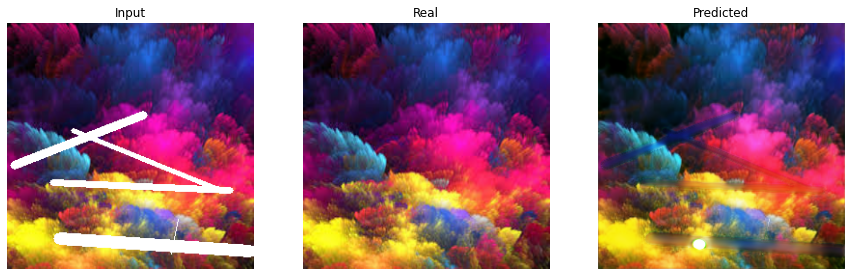

epoch: 69   loss: 0.08732795715332031
-------- psnr:  26.3234    ----- epoch:  69   count:  170
epoch: 70   loss: 0.08661025762557983
-------- psnr:  25.549168    ----- epoch:  70   count:  170
epoch: 71   loss: 0.08634190261363983
-------- psnr:  26.56963    ----- epoch:  71   count:  170


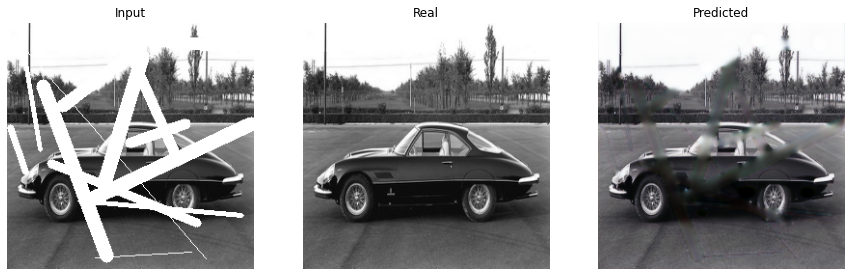

epoch: 72   loss: 0.08636044710874557
-------- psnr:  25.203524    ----- epoch:  72   count:  170
epoch: 73   loss: 0.08663833886384964
-------- psnr:  26.312773    ----- epoch:  73   count:  170
epoch: 74   loss: 0.08722097426652908
-------- psnr:  25.865513    ----- epoch:  74   count:  170
epoch: 75   loss: 0.08430603891611099
-------- psnr:  26.401157    ----- epoch:  75   count:  170
epoch: 76   loss: 0.08597538620233536
-------- psnr:  26.456419    ----- epoch:  76   count:  170
epoch: 77   loss: 0.08579347282648087
-------- psnr:  26.386644    ----- epoch:  77   count:  170
epoch: 78   loss: 0.08312835544347763
-------- psnr:  26.274885    ----- epoch:  78   count:  170
epoch: 79   loss: 0.08505851030349731
-------- psnr:  26.151434    ----- epoch:  79   count:  170
epoch: 80   loss: 0.08393395692110062
-------- psnr:  26.308184    ----- epoch:  80   count:  170
epoch: 81   loss: 0.08326689898967743
-------- psnr:  26.59053    ----- epoch:  81   count:  170


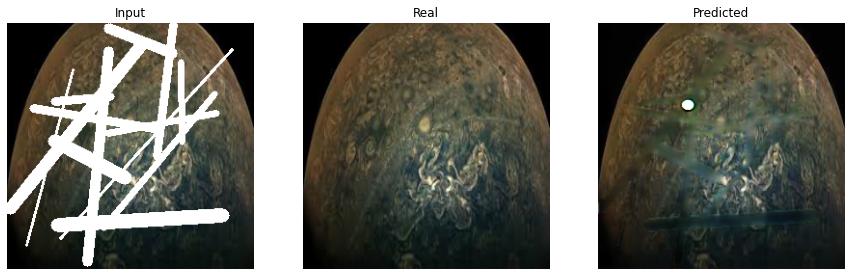

epoch: 82   loss: 0.0834922194480896
-------- psnr:  25.82718    ----- epoch:  82   count:  170
epoch: 83   loss: 0.08279271423816681
-------- psnr:  26.545252    ----- epoch:  83   count:  170
epoch: 84   loss: 0.08522716164588928
-------- psnr:  26.010452    ----- epoch:  84   count:  170
epoch: 85   loss: 0.08129902184009552
-------- psnr:  26.063154    ----- epoch:  85   count:  170
epoch: 86   loss: 0.08443478494882584
-------- psnr:  26.684326    ----- epoch:  86   count:  170


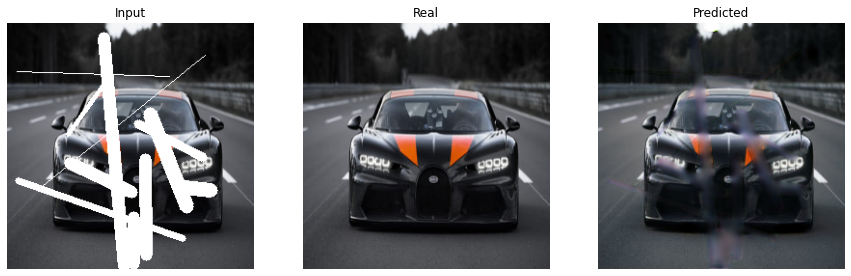

epoch: 87   loss: 0.08206483721733093
-------- psnr:  26.098576    ----- epoch:  87   count:  170
epoch: 88   loss: 0.08292003720998764
-------- psnr:  26.152927    ----- epoch:  88   count:  170
epoch: 89   loss: 0.0872168242931366
-------- psnr:  25.647797    ----- epoch:  89   count:  170
epoch: 90   loss: 0.08221673220396042
-------- psnr:  26.658884    ----- epoch:  90   count:  170
epoch: 91   loss: 0.08086889982223511
-------- psnr:  26.464794    ----- epoch:  91   count:  170
epoch: 92   loss: 0.08064217865467072
-------- psnr:  27.08709    ----- epoch:  92   count:  170


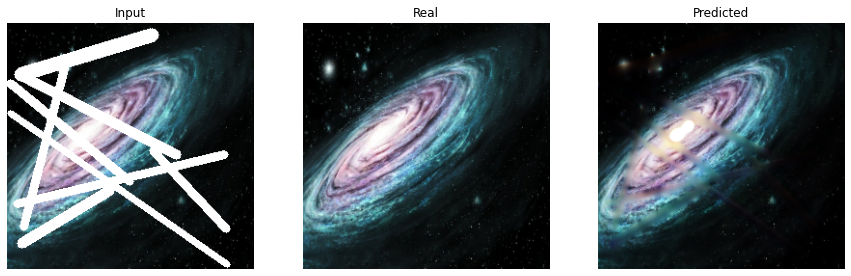

epoch: 93   loss: 0.079149030148983
-------- psnr:  26.580952    ----- epoch:  93   count:  170
epoch: 94   loss: 0.08068640530109406
-------- psnr:  27.030352    ----- epoch:  94   count:  170
epoch: 95   loss: 0.07872428745031357
-------- psnr:  27.013262    ----- epoch:  95   count:  170
epoch: 96   loss: 0.07992912828922272
-------- psnr:  26.63389    ----- epoch:  96   count:  170
epoch: 97   loss: 0.08023043721914291
-------- psnr:  26.84158    ----- epoch:  97   count:  170
epoch: 98   loss: 0.0806025043129921
-------- psnr:  26.380291    ----- epoch:  98   count:  170
epoch: 99   loss: 0.07958227396011353
-------- psnr:  26.843164    ----- epoch:  99   count:  170


In [ ]:
EPOCHS = 100
fit(train_dataset, EPOCHS, test_dataset)

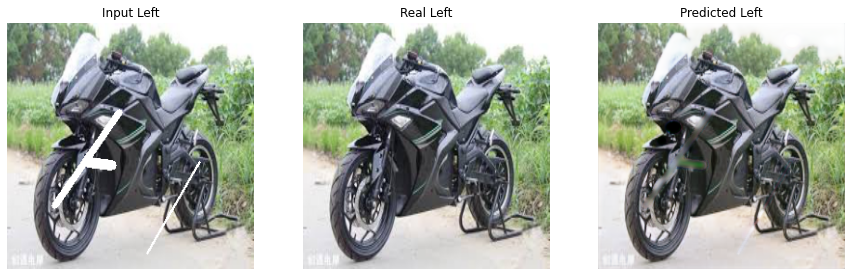

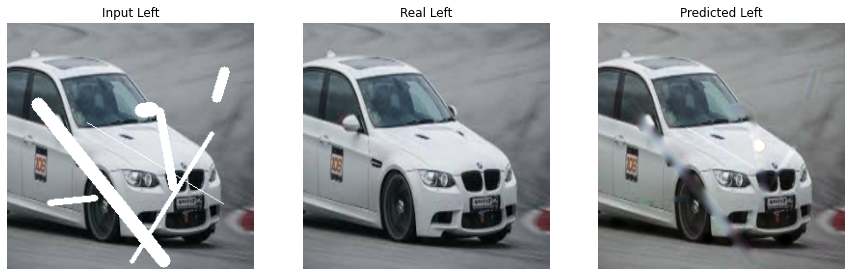

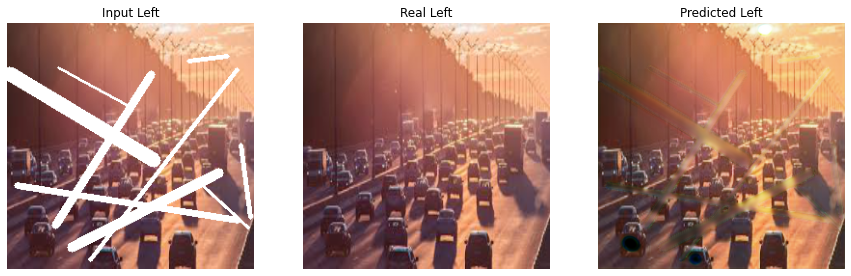

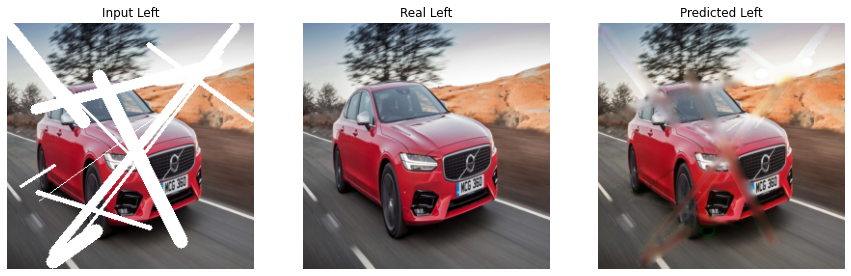

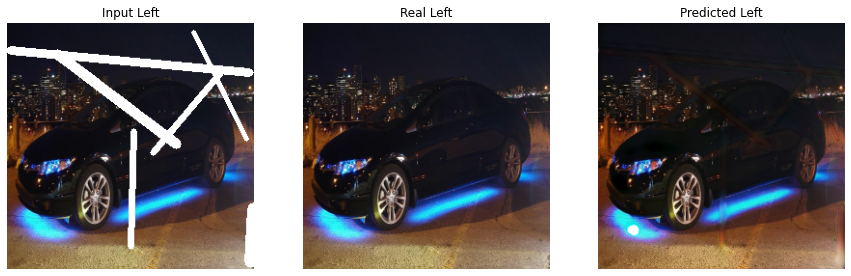

In [ ]:
for _ in range(5):
    for inputs, targets in test_dataset.take(1):
        fake = Inp_unet_model([inputs], training=True)
        plt.figure(figsize=(15,20))

        display_list = [inputs[0], targets[0], fake[0]]
        title = ['Input Left', 'Real Left', 'Predicted Left']    

        
        for i in range(3):
            plt.subplot(1, 3, i+1)
            plt.title(title[i])
            plt.imshow(display_list[i] * 0.5 + 0.5)
            plt.axis('off')
        plt.show() 

In [ ]:
############################################

In [ ]:
############################################


In [ ]:
###########################################

## Problem10: Inpainting Image with UNET (Pretrained)

### Unet Model

In [ ]:
class BuildUnet():
    def __init__(self):
        self.down_filters = [64, 128, 256, 512]
        self.up_filters = [512, 256, 128, 64]
    
    def extract_first_features(self, inputs, filters):
        x = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', 
                          kernel_initializer='he_normal', use_bias=False)(inputs)
        x = layers.LeakyReLU()(x)
        
        return x
    
    
    def DoubleConv2D(self, inputs, filters):
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', 
                          kernel_initializer='he_normal', use_bias=False)(inputs)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', 
                          kernel_initializer='he_normal', use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        
        return x
    
    
    def downsample(self, inputs, filters):
        bdown = self.DoubleConv2D(inputs, filters)
        x = layers.MaxPooling2D(pool_size=(2,2), strides=2)(bdown)
        
        return x, bdown
    
    
    def upsample(self, inputs1, inputs2, filters):
        inputs1 = layers.UpSampling2D(interpolation='bilinear')(inputs1)
        inputs1 = layers.Conv2D(filters=filters, kernel_size=(1,1),
                                kernel_initializer='he_normal', use_bias=False)(inputs1)
        inputs1 = layers.BatchNormalization()(inputs1)
        inputs1 = layers.LeakyReLU()(inputs1)
        x = layers.Concatenate()([inputs1, inputs2])
        x = self.DoubleConv2D(x, filters)
        
        return x

    
    def build_model(self, input_shape=(256,256,3)):
        inputs = layers.Input(shape=input_shape)
        x = self.extract_first_features(inputs, filters=64)
        
        # Downsampling through the model
        skips = []
        for df in self.down_filters:
            x, bdown = self.downsample(x, filters=df)
            skips.append(bdown)
        
        # Mid
        x = self.DoubleConv2D(x, filters=1024)
        
        # Upsampling and establishing the skip connections
        skips = reversed(skips)
        for uf, skip in zip(self.up_filters, skips):
            x = self.upsample(x, skip, filters=uf)
        
        # Final
        outputs = layers.Conv2D(filters=input_shape[-1], kernel_size=(1,1), activation='tanh',
                                      kernel_initializer='he_normal', use_bias=False)(x)
            
        model = Model(inputs=[inputs], outputs=[outputs])
        
        return model
        
        
        
        

In [ ]:
build_unet = BuildUnet()
unet_model = build_unet.build_model()

In [ ]:
unet_model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_208 (Conv2D)            (None, 256, 256, 64  192         ['input_5[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 256, 256, 64  0           ['conv2d_208[0][0]']             
                                )                                                           

### Prepare Inpainting Dataset

In [ ]:
LHR_TRAIN_DATA_PATH = '/media/aivn24/partition1/Khoa/CNN2/K_LHR_image/K_LHR_image/train'
LHR_VAL_DATA_PATH = '/media/aivn24/partition1/Khoa/CNN2/K_LHR_image/K_LHR_image/val'


BATCH_SIZE  = 8
BUFFER_SIZE = BATCH_SIZE*10
IMG_WIDTH   = 256
IMG_HEIGHT  = 256

def create_mask(image):
    masked_image = tf.identity(image)
    ## Prepare masking matrix
    mask = np.full((IMG_WIDTH,IMG_HEIGHT,3), 0, np.uint8)
    for _ in range(np.random.randint(1, 15)):
      # Get random x locations to start line
      x1, x2 = np.random.randint(1, IMG_WIDTH), np.random.randint(1, IMG_WIDTH)
      # Get random y locations to start line
      y1, y2 = np.random.randint(1, IMG_HEIGHT), np.random.randint(1, IMG_HEIGHT)
      # Get random thickness of the line drawn
      thickness = np.random.randint(1, 15)
      # Draw black line on the white mask
      cv2.line(mask,(x1,y1),(x2,y2),(255,255,255),thickness)

    # Perforn bitwise and operation to mak the image
#     masked_image = cv2.bitwise_and(img, mask)
    masked_image = tf.bitwise.bitwise_or(masked_image, mask)
    masked_image = tf.convert_to_tensor(masked_image)
    masked_image = tf.cast(masked_image, tf.float32)
    return masked_image

def tf_function(image):
    masked_image = tf.numpy_function(create_mask, [image], tf.float32)
    return masked_image


def load_orig(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image,channels=3)
        
    input_image  = tf.identity(image)
    target_image = tf.identity(image)
    
    input_image  = tf.cast(input_image, tf.float32)
    target_image = tf.cast(target_image, tf.float32)

    return input_image, target_image

def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image,channels=3)
        
    input_image  = tf_function(image)
    target_image = tf.identity(image)
    
    input_image  = tf.cast(input_image, tf.float32)
    target_image = tf.cast(target_image, tf.float32)

    return input_image, target_image

(256, 256, 3)
(256, 256, 3)


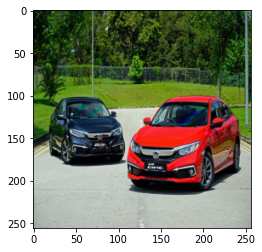

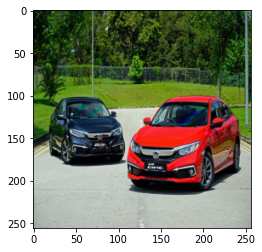

In [ ]:

input_image, target_image = load_orig(LHR_TRAIN_DATA_PATH+'/0.png')
print(input_image.shape)
print(target_image.shape)


# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(input_image/255.0)
plt.figure()
plt.imshow(target_image/255.0)

In [ ]:
# normalizing the images to [-1, 1]
def normalize(input_image, target_image):
    input_image  = (input_image / 127.5) - 1
    target_image = (target_image / 127.5) - 1

    return input_image, target_image


def load_orig_image_train(image_file):
    input_image, target_image = load_orig(image_file)
    input_image, target_image = normalize(input_image, target_image)

    return input_image, target_image

def load_orig_image_test(image_file):
    input_image, target_image = load_orig(image_file)
    input_image, target_image = normalize(input_image, target_image)

    return input_image, target_image

def load_image_train(image_file):
    input_image, target_image = load(image_file)
    input_image, target_image = normalize(input_image, target_image)

    return input_image, target_image

def load_image_test(image_file):
    input_image, target_image = load(image_file)
    input_image, target_image = normalize(input_image, target_image)

    return input_image, target_image

In [ ]:
# orig_train_dataset
orig_train_dataset = tf.data.Dataset.list_files(LHR_TRAIN_DATA_PATH + '/*.png')
orig_train_dataset = orig_train_dataset.map(load_orig_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
orig_train_dataset = orig_train_dataset.shuffle(BUFFER_SIZE)
orig_train_dataset = orig_train_dataset.batch(1)

# orig_test_dataset
orig_test_dataset = tf.data.Dataset.list_files(LHR_VAL_DATA_PATH + '/*.png')
orig_test_dataset = orig_test_dataset.map(load_orig_image_test)
orig_test_dataset = orig_test_dataset.batch(1)

# train_dataset
train_dataset = tf.data.Dataset.list_files(LHR_TRAIN_DATA_PATH + '/*.png')
train_dataset = train_dataset.map(load_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(1)

# test_dataset
test_dataset = tf.data.Dataset.list_files(LHR_VAL_DATA_PATH + '/*.png')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(1)

In [ ]:
def generator_loss(fake, target):
    l1_loss = tf.reduce_mean(tf.abs(fake-target))
    
    return l1_loss

In [ ]:
def evaluate(model, epoch):  
    psnr_mean = 0.0
    count = 0
    for inputs, targets in test_dataset:
        fake = model([inputs], training=True)
         
        psnr = tf.image.psnr(fake*0.5 + 0.5, targets*0.5 + 0.5, max_val=1.0)

        __psnr_mean = tf.math.reduce_mean(psnr)
        # psnr_mean = psnr_mean_l
        
        psnr_mean += __psnr_mean
        count =count + 1
    
    psnr_mean = psnr_mean/count
    print('-------- psnr: ', psnr_mean.numpy(), '   ----- epoch: ', epoch, '  count: ', count)
    
    return psnr_mean
    
def generate_images(model, inputs, targets):
    fake = model([inputs], training=True)
    plt.figure(figsize=(15,20))
    
    display_list = [inputs[0], targets[0], fake[0]]
    title = ['Input', 'Real', 'Predicted']    

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()        

### Train

In [ ]:
build_unet = BuildUnet()
Inp_unet_model = build_unet.build_model()

# image_input = layers.Input(shape=(IMG_HEIGHT,IMG_WIDTH,3))
# x = tf.keras.layers.Resizing(height=IMG_HEIGHT, width=IMG_WIDTH)(image_input)
# x = unet_model(x)
# Inp_unet_model= Model(inputs=image_input, outputs=x)

Inp_unet_model.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_232 (Conv2D)            (None, 256, 256, 64  192         ['input_6[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu_23 (LeakyReLU)     (None, 256, 256, 64  0           ['conv2d_232[0][0]']             
                                )                                                           

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

@tf.function
def train_step(inputs, targets):
    with tf.GradientTape() as tape:
        # output
        fake = Inp_unet_model([inputs], training=True)     
        loss = generator_loss(fake, targets)
        

    generator_gradients = tape.gradient(loss, Inp_unet_model.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, Inp_unet_model.trainable_variables))
    
    return loss

    
    
def fit(train_ds, epochs, test_ds):
    best_pnsr = 0.0
    for epoch in range(epochs):
        # Train
        total_loss = 0.0
        for inputs, targets in train_ds:
            loss = train_step(inputs, targets)
            total_loss = total_loss + loss
        total_loss = total_loss/400
        print('epoch: {}   loss: {}'.format(epoch, total_loss))
        
        pnsr = evaluate(Inp_unet_model, epoch)        
        if best_pnsr < pnsr:
            best_pnsr = pnsr
            
            for inputs, targets in test_ds.take(1):
                generate_images(Inp_unet_model, inputs, targets)


epoch: 0   loss: 0.338600754737854
-------- psnr:  13.690893    ----- epoch:  0   count:  170


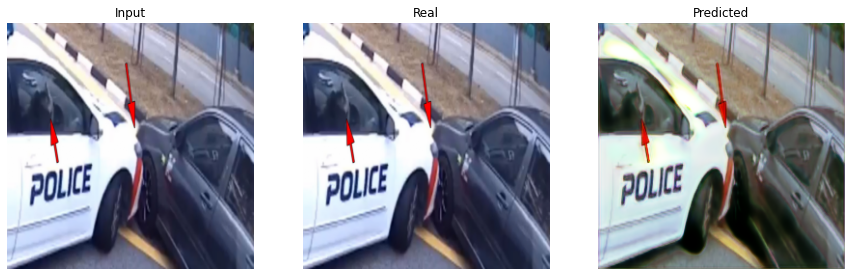

epoch: 1   loss: 0.2354094684123993
-------- psnr:  13.590171    ----- epoch:  1   count:  170
epoch: 2   loss: 0.20632487535476685
-------- psnr:  13.819217    ----- epoch:  2   count:  170


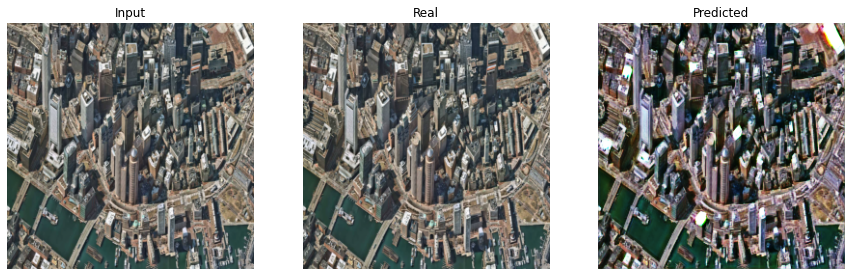

epoch: 3   loss: 0.18855972588062286
-------- psnr:  14.239017    ----- epoch:  3   count:  170


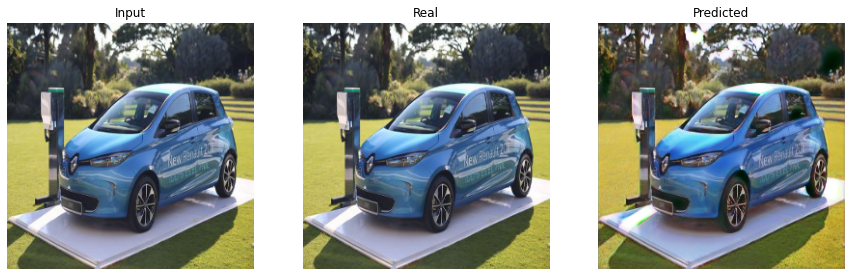

epoch: 4   loss: 0.17490991950035095
-------- psnr:  14.282576    ----- epoch:  4   count:  170


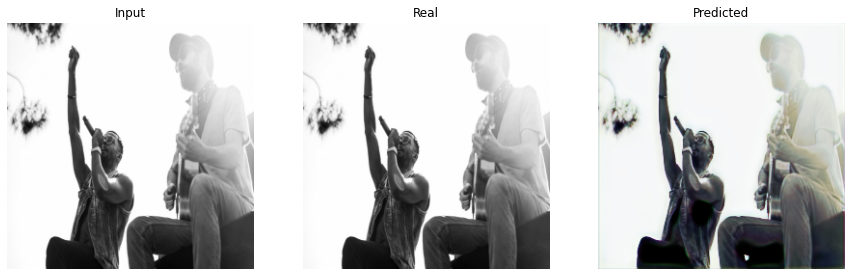

epoch: 5   loss: 0.1664714366197586
-------- psnr:  14.259948    ----- epoch:  5   count:  170
epoch: 6   loss: 0.15585225820541382
-------- psnr:  15.077398    ----- epoch:  6   count:  170


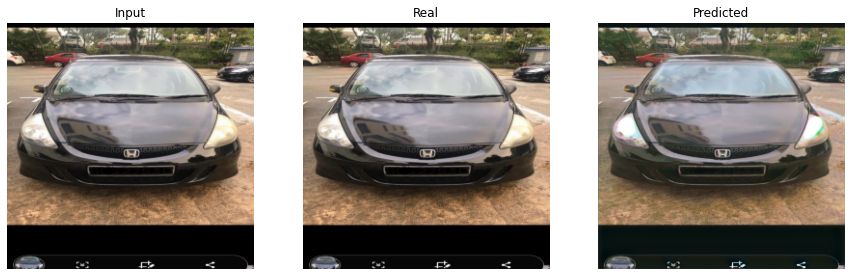

epoch: 7   loss: 0.15067578852176666
-------- psnr:  14.287251    ----- epoch:  7   count:  170
epoch: 8   loss: 0.1460038125514984
-------- psnr:  14.227358    ----- epoch:  8   count:  170
epoch: 9   loss: 0.14032770693302155
-------- psnr:  14.737257    ----- epoch:  9   count:  170
epoch: 10   loss: 0.1369195431470871
-------- psnr:  14.205286    ----- epoch:  10   count:  170
epoch: 11   loss: 0.13003379106521606
-------- psnr:  13.91375    ----- epoch:  11   count:  170
epoch: 12   loss: 0.12876716256141663
-------- psnr:  14.336207    ----- epoch:  12   count:  170
epoch: 13   loss: 0.1256454885005951
-------- psnr:  14.642795    ----- epoch:  13   count:  170
epoch: 14   loss: 0.12240230292081833
-------- psnr:  14.540108    ----- epoch:  14   count:  170
epoch: 15   loss: 0.11783213913440704
-------- psnr:  13.6626    ----- epoch:  15   count:  170
epoch: 16   loss: 0.11744540929794312
-------- psnr:  14.432572    ----- epoch:  16   count:  170
epoch: 17   loss: 0.114044256508

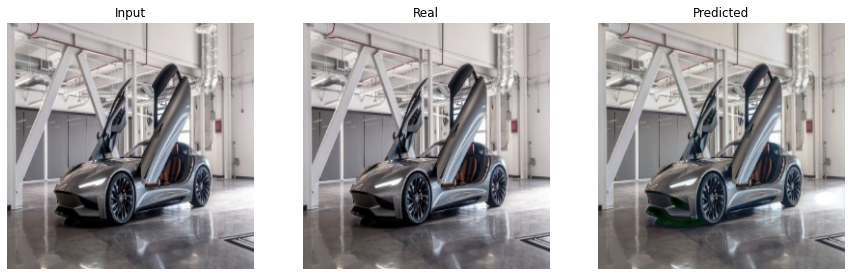

epoch: 43   loss: 0.07878757268190384
-------- psnr:  14.31351    ----- epoch:  43   count:  170
epoch: 44   loss: 0.07768258452415466
-------- psnr:  14.175372    ----- epoch:  44   count:  170
epoch: 45   loss: 0.07757642865180969
-------- psnr:  14.312162    ----- epoch:  45   count:  170
epoch: 46   loss: 0.07646293938159943
-------- psnr:  14.499514    ----- epoch:  46   count:  170
epoch: 47   loss: 0.07717178016901016
-------- psnr:  14.757889    ----- epoch:  47   count:  170
epoch: 48   loss: 0.07259026914834976
-------- psnr:  14.448557    ----- epoch:  48   count:  170
epoch: 49   loss: 0.07343228161334991
-------- psnr:  14.402427    ----- epoch:  49   count:  170
epoch: 50   loss: 0.07404619455337524
-------- psnr:  14.20629    ----- epoch:  50   count:  170
epoch: 51   loss: 0.07281684875488281
-------- psnr:  14.147642    ----- epoch:  51   count:  170
epoch: 52   loss: 0.07087662816047668
-------- psnr:  14.29864    ----- epoch:  52   count:  170
epoch: 53   loss: 0.069

In [ ]:
EPOCHS = 100
fit(orig_train_dataset, EPOCHS, orig_test_dataset)

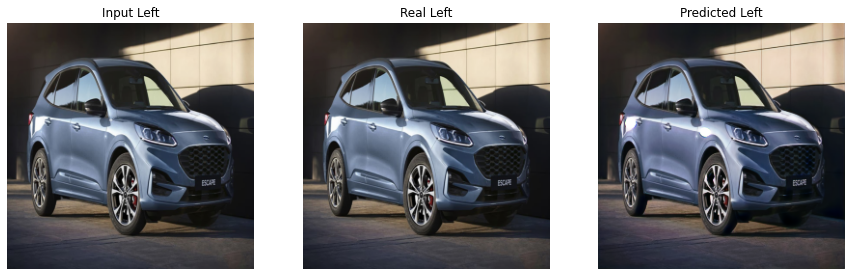

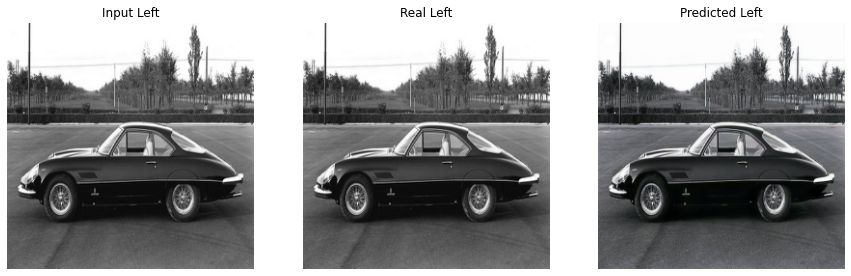

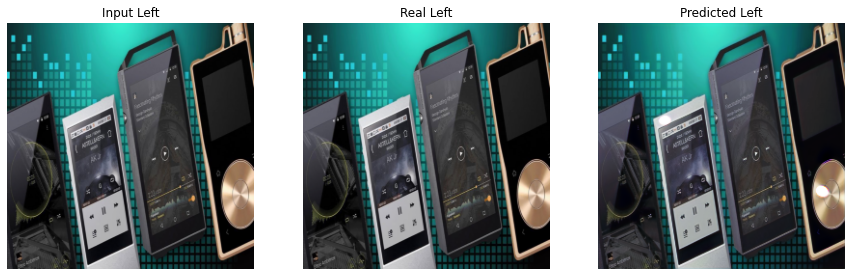

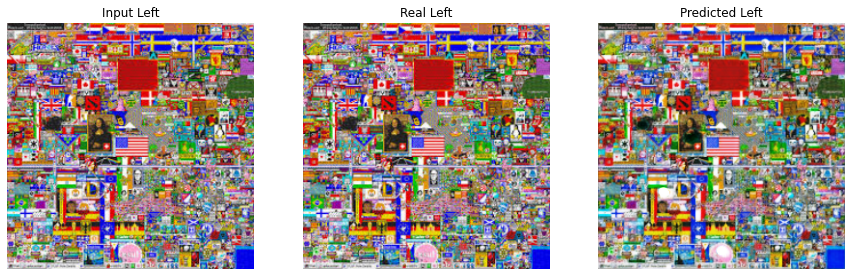

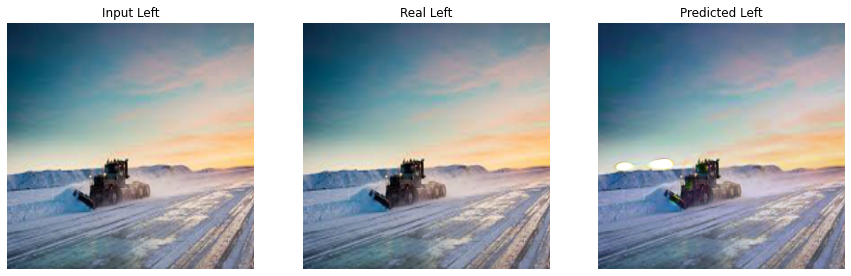

In [ ]:
for _ in range(5):
    for inputs, targets in orig_test_dataset.take(1):
        fake = Inp_unet_model([inputs], training=True)
        plt.figure(figsize=(15,20))

        display_list = [inputs[0], targets[0], fake[0]]
        title = ['Input Left', 'Real Left', 'Predicted Left']    

        
        for i in range(3):
            plt.subplot(1, 3, i+1)
            plt.title(title[i])
            plt.imshow(display_list[i] * 0.5 + 0.5)
            plt.axis('off')
        plt.show() 

epoch: 0   loss: 0.1772579401731491
-------- psnr:  21.522741    ----- epoch:  0   count:  170


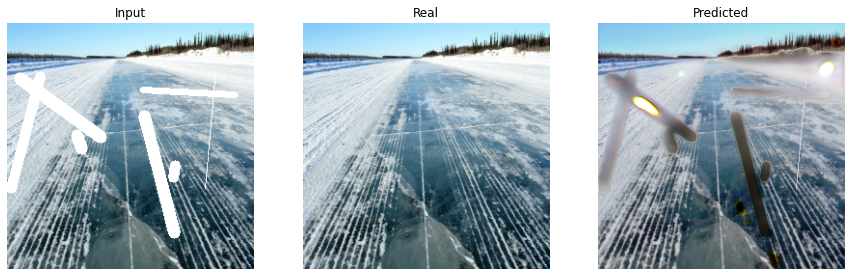

epoch: 1   loss: 0.13885271549224854
-------- psnr:  22.19013    ----- epoch:  1   count:  170


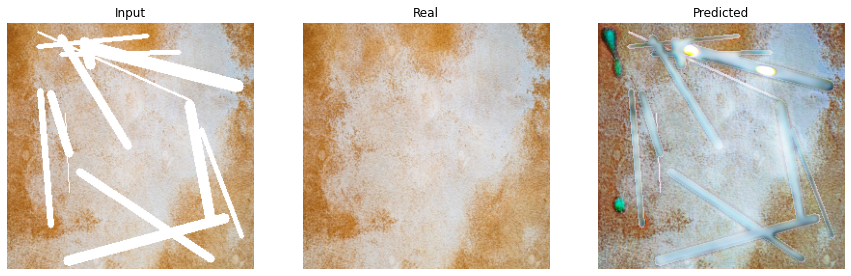

epoch: 2   loss: 0.12485137581825256
-------- psnr:  23.226383    ----- epoch:  2   count:  170


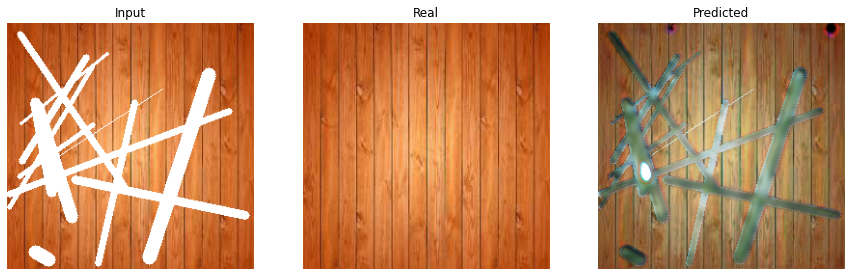

epoch: 3   loss: 0.1184949278831482
-------- psnr:  23.578785    ----- epoch:  3   count:  170


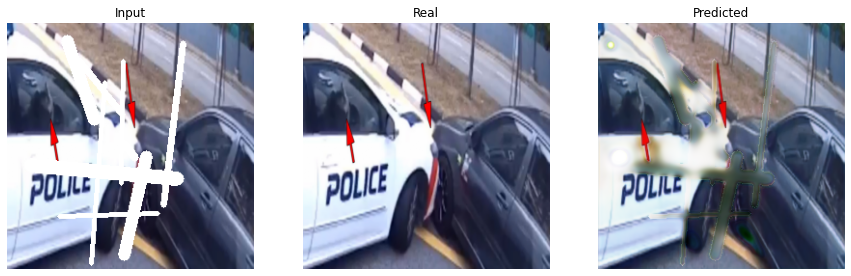

epoch: 4   loss: 0.11575029045343399
-------- psnr:  23.66385    ----- epoch:  4   count:  170


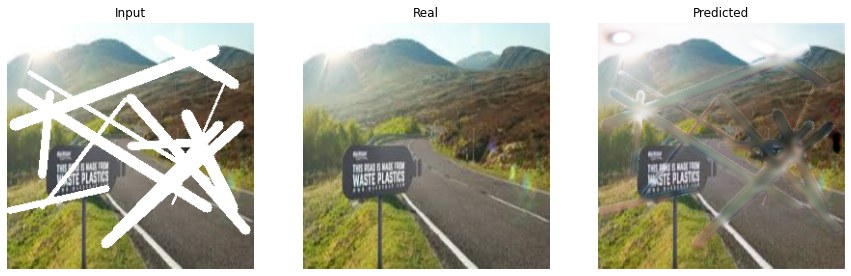

epoch: 5   loss: 0.10949506610631943
-------- psnr:  24.227198    ----- epoch:  5   count:  170


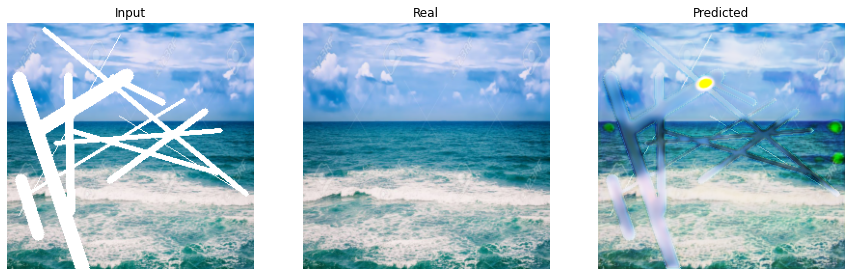

epoch: 6   loss: 0.1058562770485878
-------- psnr:  24.177597    ----- epoch:  6   count:  170
epoch: 7   loss: 0.10317093878984451
-------- psnr:  23.576363    ----- epoch:  7   count:  170
epoch: 8   loss: 0.10493112355470657
-------- psnr:  24.405796    ----- epoch:  8   count:  170


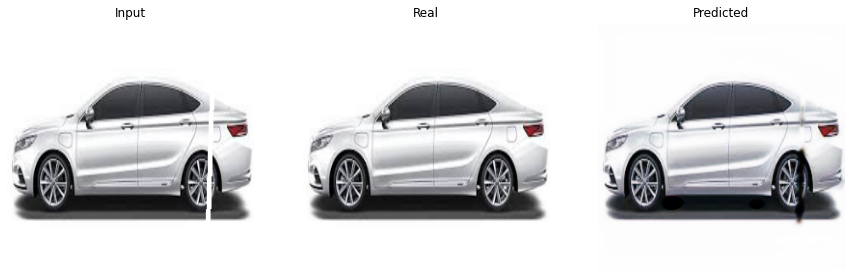

epoch: 9   loss: 0.10161127150058746
-------- psnr:  24.053041    ----- epoch:  9   count:  170
epoch: 10   loss: 0.09867150336503983
-------- psnr:  25.090637    ----- epoch:  10   count:  170


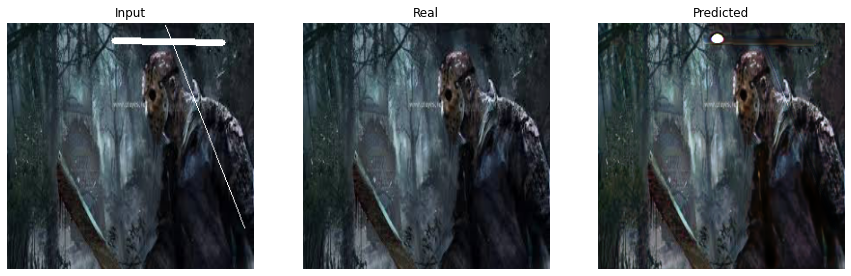

epoch: 11   loss: 0.09970580786466599
-------- psnr:  24.242016    ----- epoch:  11   count:  170
epoch: 12   loss: 0.09700016677379608
-------- psnr:  25.302475    ----- epoch:  12   count:  170


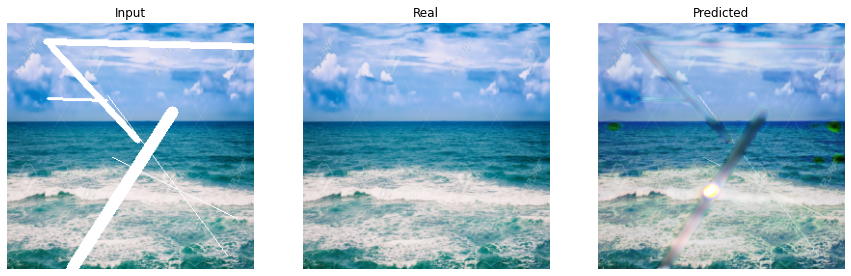

epoch: 13   loss: 0.09471684694290161
-------- psnr:  25.198515    ----- epoch:  13   count:  170
epoch: 14   loss: 0.09409356862306595
-------- psnr:  25.444115    ----- epoch:  14   count:  170


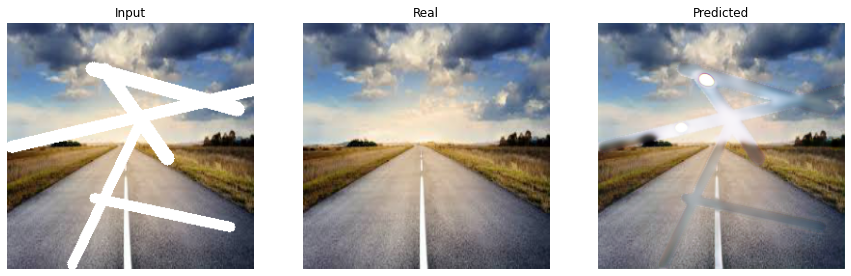

epoch: 15   loss: 0.09167120605707169
-------- psnr:  25.0564    ----- epoch:  15   count:  170
epoch: 16   loss: 0.09348835796117783
-------- psnr:  25.92972    ----- epoch:  16   count:  170


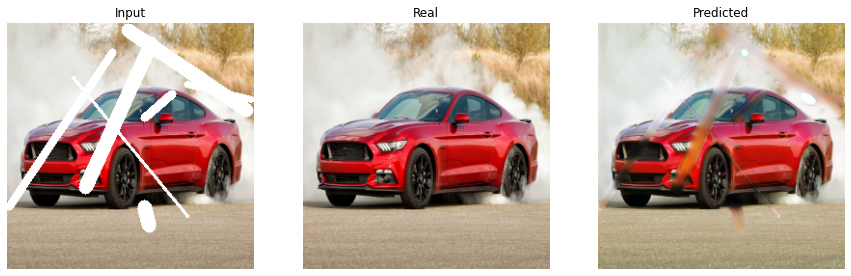

epoch: 17   loss: 0.09161447733640671
-------- psnr:  25.099613    ----- epoch:  17   count:  170
epoch: 18   loss: 0.0913747027516365
-------- psnr:  25.756517    ----- epoch:  18   count:  170
epoch: 19   loss: 0.08951156586408615
-------- psnr:  25.834892    ----- epoch:  19   count:  170
epoch: 20   loss: 0.09028332680463791
-------- psnr:  25.446524    ----- epoch:  20   count:  170
epoch: 21   loss: 0.08714940398931503
-------- psnr:  25.747501    ----- epoch:  21   count:  170
epoch: 22   loss: 0.08965727686882019
-------- psnr:  25.764528    ----- epoch:  22   count:  170
epoch: 23   loss: 0.08864498138427734
-------- psnr:  25.270945    ----- epoch:  23   count:  170
epoch: 24   loss: 0.08690933883190155
-------- psnr:  25.832003    ----- epoch:  24   count:  170
epoch: 25   loss: 0.08567805588245392
-------- psnr:  25.279404    ----- epoch:  25   count:  170
epoch: 26   loss: 0.08523222804069519
-------- psnr:  25.675179    ----- epoch:  26   count:  170
epoch: 27   loss: 0.0

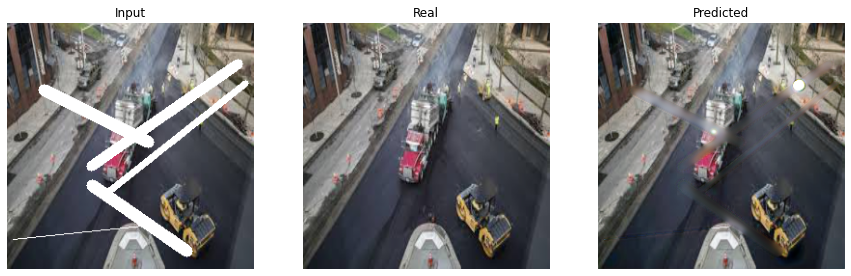

epoch: 28   loss: 0.08612193912267685
-------- psnr:  25.89375    ----- epoch:  28   count:  170
epoch: 29   loss: 0.08521734178066254
-------- psnr:  26.092897    ----- epoch:  29   count:  170


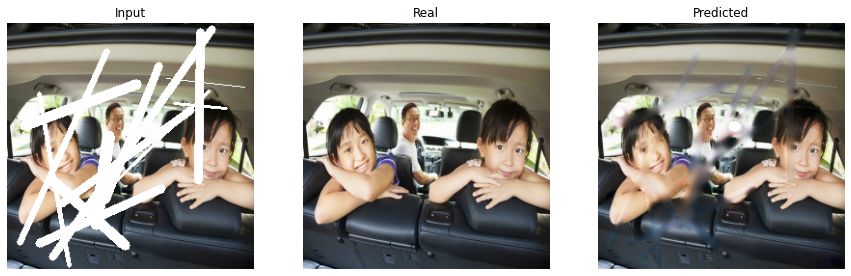

epoch: 30   loss: 0.08406125754117966
-------- psnr:  26.228395    ----- epoch:  30   count:  170


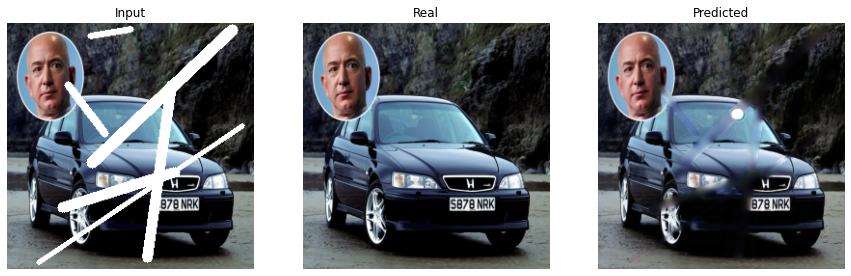

epoch: 31   loss: 0.08432509750127792
-------- psnr:  26.362356    ----- epoch:  31   count:  170


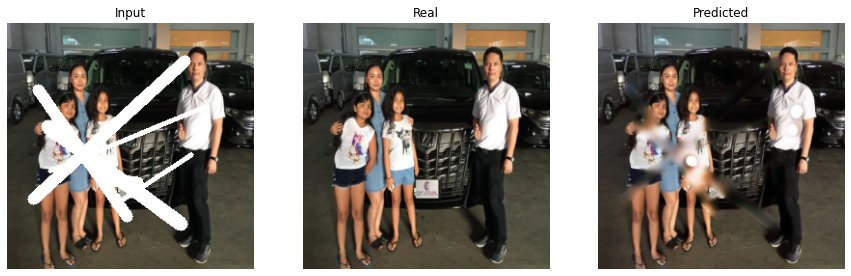

epoch: 32   loss: 0.08493094146251678
-------- psnr:  25.546692    ----- epoch:  32   count:  170
epoch: 33   loss: 0.08423036336898804
-------- psnr:  25.426838    ----- epoch:  33   count:  170
epoch: 34   loss: 0.08308757096529007
-------- psnr:  26.312307    ----- epoch:  34   count:  170
epoch: 35   loss: 0.08064591139554977
-------- psnr:  26.15312    ----- epoch:  35   count:  170
epoch: 36   loss: 0.08121329545974731
-------- psnr:  26.57903    ----- epoch:  36   count:  170


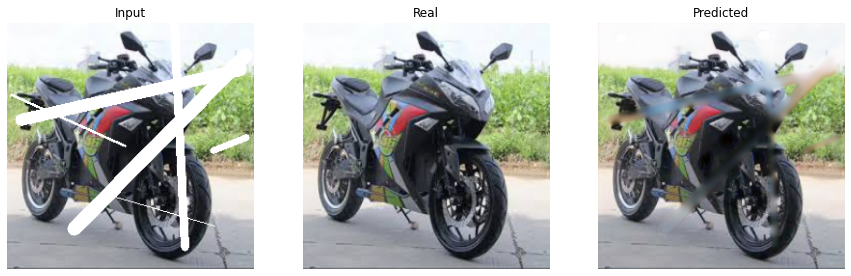

epoch: 37   loss: 0.08102219551801682
-------- psnr:  26.306644    ----- epoch:  37   count:  170
epoch: 38   loss: 0.08197766542434692
-------- psnr:  25.728237    ----- epoch:  38   count:  170
epoch: 39   loss: 0.08105847239494324
-------- psnr:  26.095676    ----- epoch:  39   count:  170
epoch: 40   loss: 0.08080505579710007
-------- psnr:  26.941305    ----- epoch:  40   count:  170


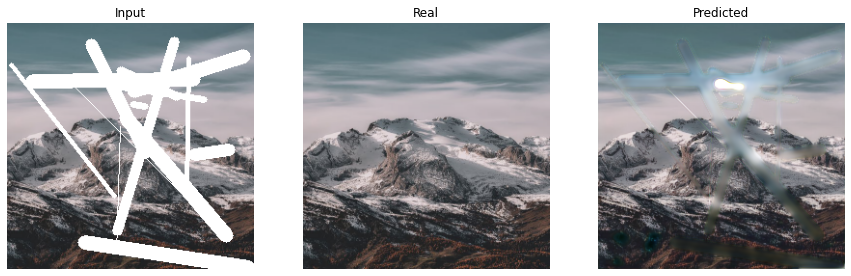

epoch: 41   loss: 0.08121039718389511
-------- psnr:  26.377863    ----- epoch:  41   count:  170
epoch: 42   loss: 0.07955500483512878
-------- psnr:  25.90285    ----- epoch:  42   count:  170
epoch: 43   loss: 0.08243495970964432
-------- psnr:  26.226336    ----- epoch:  43   count:  170
epoch: 44   loss: 0.0774354487657547
-------- psnr:  26.252993    ----- epoch:  44   count:  170
epoch: 45   loss: 0.07869553565979004
-------- psnr:  26.489695    ----- epoch:  45   count:  170
epoch: 46   loss: 0.07950188964605331
-------- psnr:  26.207264    ----- epoch:  46   count:  170
epoch: 47   loss: 0.07806125283241272
-------- psnr:  26.693058    ----- epoch:  47   count:  170
epoch: 48   loss: 0.07688195258378983
-------- psnr:  26.661507    ----- epoch:  48   count:  170
epoch: 49   loss: 0.07767240703105927
-------- psnr:  26.422812    ----- epoch:  49   count:  170
epoch: 50   loss: 0.07740931212902069
-------- psnr:  26.816315    ----- epoch:  50   count:  170
epoch: 51   loss: 0.07

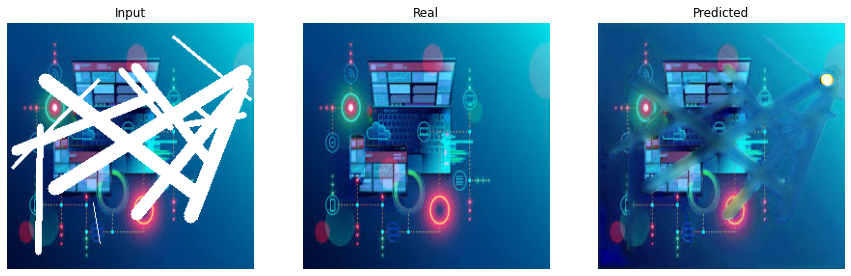

epoch: 55   loss: 0.07579357922077179
-------- psnr:  26.519207    ----- epoch:  55   count:  170
epoch: 56   loss: 0.07582744210958481
-------- psnr:  26.40168    ----- epoch:  56   count:  170
epoch: 57   loss: 0.07442616671323776
-------- psnr:  26.817898    ----- epoch:  57   count:  170
epoch: 58   loss: 0.07592535763978958
-------- psnr:  26.884153    ----- epoch:  58   count:  170
epoch: 59   loss: 0.07473543286323547
-------- psnr:  25.936314    ----- epoch:  59   count:  170
epoch: 60   loss: 0.07536985725164413
-------- psnr:  26.66759    ----- epoch:  60   count:  170
epoch: 61   loss: 0.07650022953748703
-------- psnr:  26.697786    ----- epoch:  61   count:  170
epoch: 62   loss: 0.07499095052480698
-------- psnr:  26.891163    ----- epoch:  62   count:  170
epoch: 63   loss: 0.07486025989055634
-------- psnr:  26.575222    ----- epoch:  63   count:  170
epoch: 64   loss: 0.07415491342544556
-------- psnr:  26.257076    ----- epoch:  64   count:  170
epoch: 65   loss: 0.07

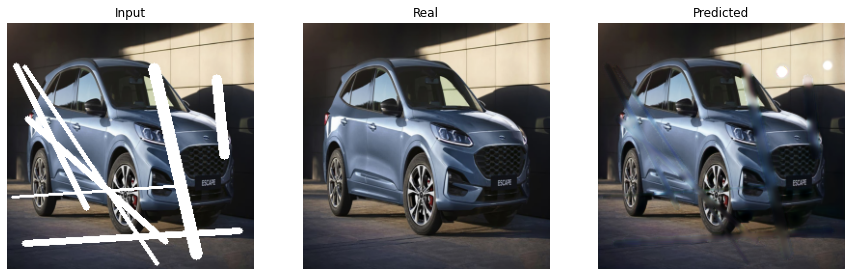

epoch: 67   loss: 0.07292412966489792
-------- psnr:  26.713669    ----- epoch:  67   count:  170
epoch: 68   loss: 0.07370852679014206
-------- psnr:  27.63561    ----- epoch:  68   count:  170


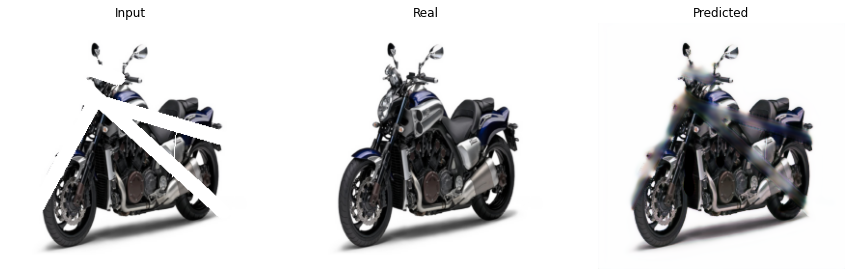

epoch: 69   loss: 0.07324569672346115
-------- psnr:  27.003641    ----- epoch:  69   count:  170
epoch: 70   loss: 0.0733758956193924
-------- psnr:  26.567804    ----- epoch:  70   count:  170
epoch: 71   loss: 0.07314851880073547
-------- psnr:  27.187317    ----- epoch:  71   count:  170
epoch: 72   loss: 0.07324493676424026
-------- psnr:  26.960363    ----- epoch:  72   count:  170
epoch: 73   loss: 0.0726669579744339
-------- psnr:  27.24287    ----- epoch:  73   count:  170
epoch: 74   loss: 0.07168962806463242
-------- psnr:  26.684294    ----- epoch:  74   count:  170
epoch: 75   loss: 0.07289831340312958
-------- psnr:  26.634459    ----- epoch:  75   count:  170
epoch: 76   loss: 0.07118050754070282
-------- psnr:  26.322124    ----- epoch:  76   count:  170
epoch: 77   loss: 0.07279065251350403
-------- psnr:  27.4997    ----- epoch:  77   count:  170
epoch: 78   loss: 0.07007104903459549
-------- psnr:  27.189327    ----- epoch:  78   count:  170
epoch: 79   loss: 0.07106

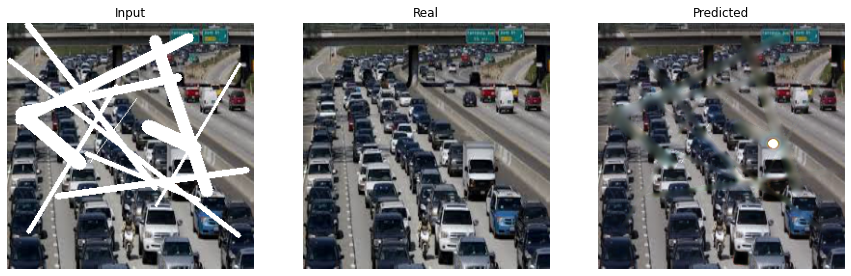

epoch: 97   loss: 0.06902159005403519
-------- psnr:  27.06706    ----- epoch:  97   count:  170
epoch: 98   loss: 0.06854236871004105
-------- psnr:  27.136703    ----- epoch:  98   count:  170
epoch: 99   loss: 0.06984768062829971
-------- psnr:  27.255098    ----- epoch:  99   count:  170


In [ ]:
EPOCHS = 100
fit(train_dataset, EPOCHS, test_dataset)

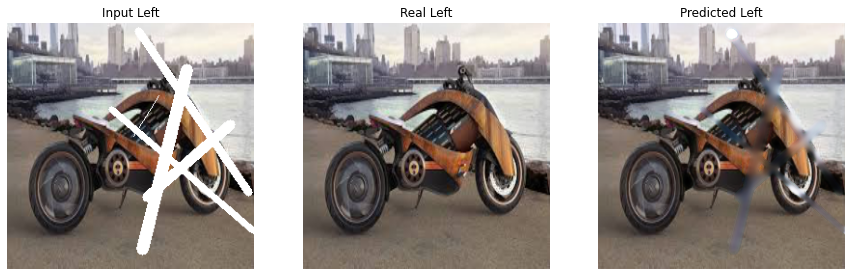

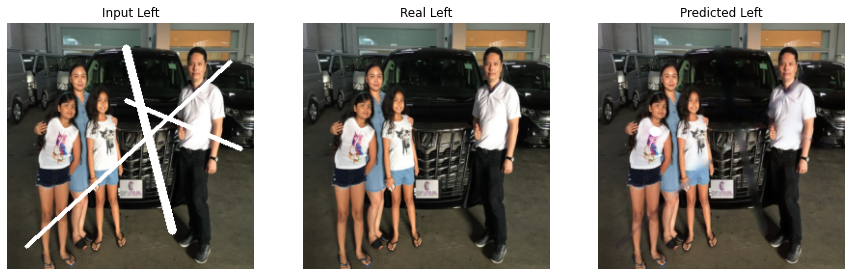

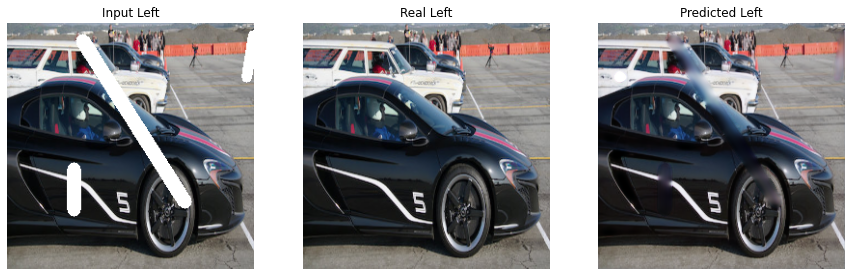

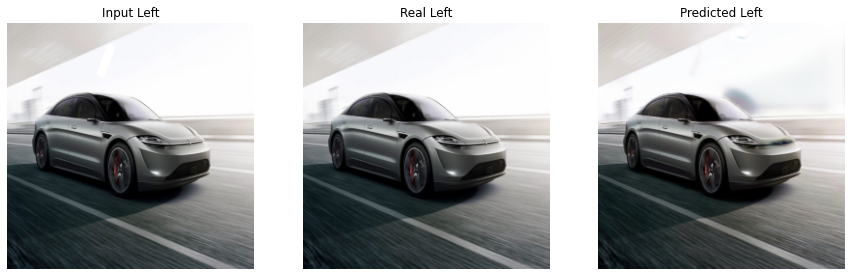

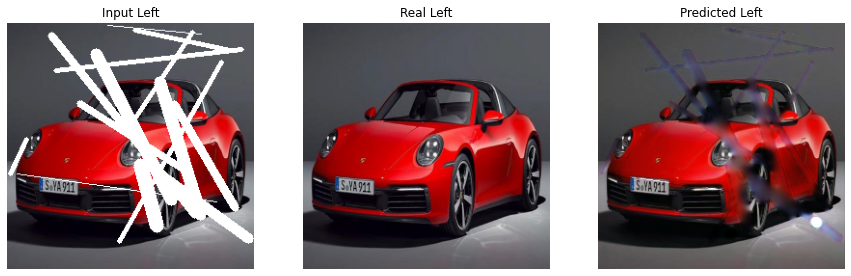

In [ ]:
for _ in range(5):
    for inputs, targets in test_dataset.take(1):
        fake = Inp_unet_model([inputs], training=True)
        plt.figure(figsize=(15,20))

        display_list = [inputs[0], targets[0], fake[0]]
        title = ['Input Left', 'Real Left', 'Predicted Left']    

        
        for i in range(3):
            plt.subplot(1, 3, i+1)
            plt.title(title[i])
            plt.imshow(display_list[i] * 0.5 + 0.5)
            plt.axis('off')
        plt.show() 